<div style="border: 2px solid; padding: 10px; border-radius: 5px;">
<div align="center">

# Machine Learning 
## Bioinformatics for Computational Genomics  
### A.Y. 2024-25 
**Students:** Riccardo Caccia, Giuseppe Gautieri  
**Id:** 271218, 271252 <br>
**Emails:**  riccardo2.caccia@mail.polimi.it, giuseppe.gautieri@mail.polimi.it
</div>

##  SUPPORT2 (Study to Understand Prognoses Preferences Outcomes and Risks of Treatment) dataset


> Main library used

In [27]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning) #ignore future warning
%matplotlib inline

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import statsmodels.api as sm
import statsmodels.formula.api as smf

from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE

np.random.seed(0)

> Installing the Dataset Package

In [28]:
?pip install ucimlrepo

Object `pip install ucimlrepo` not found.


> Loading the dataset

In [29]:
from ucimlrepo import fetch_ucirepo
  
# fetch dataset 
support2 = fetch_ucirepo(id=880) 
  
# data (as pandas dataframes) 
X = support2.data.features 
y = support2.data.targets 
  
# metadata 
print(support2.metadata) 
  
# variable information 
print(support2.variables) 

dataset = pd.concat([X, y], axis = 1, join="outer")

{'uci_id': 880, 'name': 'SUPPORT2', 'repository_url': 'https://archive.ics.uci.edu/dataset/880/support2', 'data_url': 'https://archive.ics.uci.edu/static/public/880/data.csv', 'abstract': "This dataset comprises 9105 individual critically ill patients across 5 United States medical centers, accessioned throughout 1989-1991 and 1992-1994.\nEach row concerns hospitalized patient records who met the inclusion and exclusion criteria for nine disease categories: acute respiratory failure, chronic obstructive pulmonary disease, congestive heart failure, liver disease, coma, colon cancer, lung cancer, multiple organ system failure with malignancy, and multiple organ system failure with sepsis. The goal is to determine these patients' 2- and 6-month survival rates based on several physiologic, demographics, and disease severity information. \nIt is an important problem because it addresses the growing national concern over patients' loss of control near the end of life. It enables earlier deci

In [30]:
# If the dataset site is not responding use the copy of the dataset in your pc 

# dataset = pd.read_csv('support2_dataset.csv')
# dataset

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">

## REMARK 1
</div>


Remove the columns that can heavily influence analysis on our model (aps, sps, surv2m, surv6m, prg2m, prg6m, dnr, and dnrday).

In [31]:
dataset = dataset.drop(columns=['aps', 'sps', 'surv2m', 'surv6m', 'prg2m', 'prg6m', 'dnr', 'dnrday'])

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">

## REMARK 2
</div>


high percentage of missing values columns are fitted with a couple of recommended imputation values.

In [32]:
dataset.replace({"male": 0, "female": 1}, inplace=True)
# Riempimento dei valori NaN
dataset["alb"] = dataset["alb"].fillna(3.5)
dataset["pafi"] = dataset["pafi"].fillna(333.3)
dataset["bili"] = dataset["bili"].fillna(1.01)
dataset["crea"] = dataset["crea"].fillna(1.01)
dataset["bun"] = dataset["bun"].fillna(6.51)
dataset["wblc"] = dataset["wblc"].fillna(9)
dataset["urine"] = dataset["urine"].fillna(2502)

dataset.dropna(subset=["totcst"], inplace=True)

dataset.isnull().sum()

age            0
sex            0
dzgroup        0
dzclass        0
num.co         0
edu         1480
income      2687
scoma          0
charges       74
totcst         0
totmcst     2587
avtisst       75
race          38
hday           0
diabetes       0
dementia       0
ca             0
meanbp         0
wblc           0
hrt            0
resp           0
temp           0
pafi           0
alb            0
bili           0
crea           0
sod            0
ph          2064
glucose     4354
bun            0
urine          0
adlp        5027
adls        2634
adlsc          0
death          0
hospdead       0
sfdm2       1275
dtype: int64

>Preprocesses data by encoding categorical features, scaling numerical features, and then imputing any missing values using a K-Nearest Neighbors approach

In [33]:
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler

# encode categorical
Y = dataset["totcst"].to_numpy()
X_encoded = pd.get_dummies(dataset, drop_first=True)
X_encoded.drop(columns=["totcst"], inplace=True)

# Scale since knn uses distances
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_encoded)

# Impute values
imputer = KNNImputer(n_neighbors=5)
X_imputed = imputer.fit_transform(X_scaled)

# replace missing values with imputed
X_imputed = pd.DataFrame(X_imputed, columns=X_encoded.columns)
X_imputed.isnull().sum()

age                           0
sex                           0
num.co                        0
edu                           0
scoma                         0
charges                       0
totmcst                       0
avtisst                       0
hday                          0
diabetes                      0
dementia                      0
meanbp                        0
wblc                          0
hrt                           0
resp                          0
temp                          0
pafi                          0
alb                           0
bili                          0
crea                          0
sod                           0
ph                            0
glucose                       0
bun                           0
urine                         0
adlp                          0
adls                          0
adlsc                         0
death                         0
hospdead                      0
dzgroup_CHF                   0
dzgroup_

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">

<div align="center">

# Inspection of the DataSet and Preliminary analysis

</div>


## 1. Overview of the Dataset and Management of Missing Values <br>
understand the data structure, spot patterns, anomalies, relationships between variables, and get things ready for preprocessing and modeling.

In [34]:
# Get all columns names and give an 
# overview on the head of the dataset 
dataset.columns
dataset.head(5)

Index(['age', 'sex', 'dzgroup', 'dzclass', 'num.co', 'edu', 'income', 'scoma',
       'charges', 'totcst', 'totmcst', 'avtisst', 'race', 'hday', 'diabetes',
       'dementia', 'ca', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi',
       'alb', 'bili', 'crea', 'sod', 'ph', 'glucose', 'bun', 'urine', 'adlp',
       'adls', 'adlsc', 'death', 'hospdead', 'sfdm2'],
      dtype='object')

,age,sex,dzgroup,dzclass,num.co,edu,income,scoma,charges,totcst,...,ph,glucose,bun,urine,adlp,adls,adlsc,death,hospdead,sfdm2
14,43.53998,1,ARF/MOSF w/Sepsis,ARF/MOSF,1,NaN,NaN,26.0,706577.0,390460.5000,...,7.399414,NaN,6.51,2502.0,NaN,NaN,2.764160,0,0,SIP>=30
17,63.66299,1,ARF/MOSF w/Sepsis,ARF/MOSF,0,22.0,$25-$50k,26.0,283303.0,156674.1250,...,7.449219,NaN,6.51,2502.0,NaN,0.0,0.000000,1,1,<2 mo. follow-up
18,31.84399,0,Cirrhosis,COPD/CHF/Cirrhosis,2,16.0,under $11k,0.0,27985.0,17528.4375,...,NaN,NaN,6.51,2502.0,7.0,7.0,7.000000,1,1,<2 mo. follow-up
21,48.70398,0,Lung Cancer,Cancer,0,16.0,NaN,0.0,55384.0,33002.5000,...,7.519531,NaN,6.51,2502.0,NaN,NaN,3.263672,1,0,<2 mo. follow-up
22,49.61298,1,ARF/MOSF w/Sepsis,ARF/MOSF,1,12.0,$25-$50k,0.0,542266.0,288592.2500,...,7.399414,NaN,6.51,2502.0,NaN,5.0,5.000000,0,0,adl>=4 (>=5 if sur)


In [35]:
# Some info about the data type and non-null per column
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8217 entries, 14 to 9104
Data columns (total 37 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       8217 non-null   float64
 1   sex       8217 non-null   int64  
 2   dzgroup   8217 non-null   object 
 3   dzclass   8217 non-null   object 
 4   num.co    8217 non-null   int64  
 5   edu       6737 non-null   float64
 6   income    5530 non-null   object 
 7   scoma     8217 non-null   float64
 8   charges   8143 non-null   float64
 9   totcst    8217 non-null   float64
 10  totmcst   5630 non-null   float64
 11  avtisst   8142 non-null   float64
 12  race      8179 non-null   object 
 13  hday      8217 non-null   int64  
 14  diabetes  8217 non-null   int64  
 15  dementia  8217 non-null   int64  
 16  ca        8217 non-null   object 
 17  meanbp    8217 non-null   float64
 18  wblc      8217 non-null   float64
 19  hrt       8217 non-null   float64
 20  resp      8217 non-null   float64


In [36]:
# Description of the dataset 
dataset.describe()

,age,sex,num.co,edu,scoma,charges,totcst,totmcst,avtisst,hday,...,sod,ph,glucose,bun,urine,adlp,adls,adlsc,death,hospdead
count,8217.000000,8217.000000,8217.000000,6737.000000,8217.000000,8.143000e+03,8217.000000,5630.000000,8142.000000,8217.000000,...,8217.000000,6153.000000,3863.000000,8217.000000,8217.000000,3190.000000,5583.000000,8217.000000,8217.000000,8217.000000
mean,62.974537,0.438116,1.901424,11.761318,11.906292,5.690792e+04,30825.867768,28828.877838,22.369421,4.347937,...,137.507850,7.415791,161.552161,19.067980,2360.220785,1.157994,1.649830,1.904340,0.686990,0.253621
std,15.539789,0.496186,1.351914,3.428178,24.616592,9.664733e+04,45780.820986,43604.261932,13.247257,9.134278,...,6.061814,0.080516,90.154346,22.562969,964.618210,1.726554,2.227013,1.997476,0.463746,0.435109
min,18.118990,0.000000,0.000000,0.000000,0.000000,1.169000e+03,0.000000,-102.719970,1.000000,1.000000,...,110.000000,6.829102,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,53.160980,0.000000,1.000000,10.000000,0.000000,9.384500e+03,5929.566400,5177.404300,12.000000,1.000000,...,134.000000,7.379883,104.000000,6.510000,2200.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,65.080990,0.000000,2.000000,12.000000,0.000000,2.371600e+04,14452.734400,13223.500000,19.000000,1.000000,...,137.000000,7.429688,136.000000,6.510000,2502.000000,0.000000,1.000000,1.166748,1.000000,0.000000
75%,74.359990,1.000000,3.000000,14.000000,9.000000,6.174900e+04,36087.937500,34223.601600,31.000000,3.000000,...,141.000000,7.469727,189.000000,23.000000,2502.000000,2.000000,3.000000,3.000000,1.000000,1.000000
max,101.847960,1.000000,9.000000,31.000000,100.000000,1.435423e+06,633212.000000,710682.000000,83.000000,148.000000,...,181.000000,7.769531,1092.000000,300.000000,9000.000000,7.000000,7.000000,7.073242,1.000000,1.000000


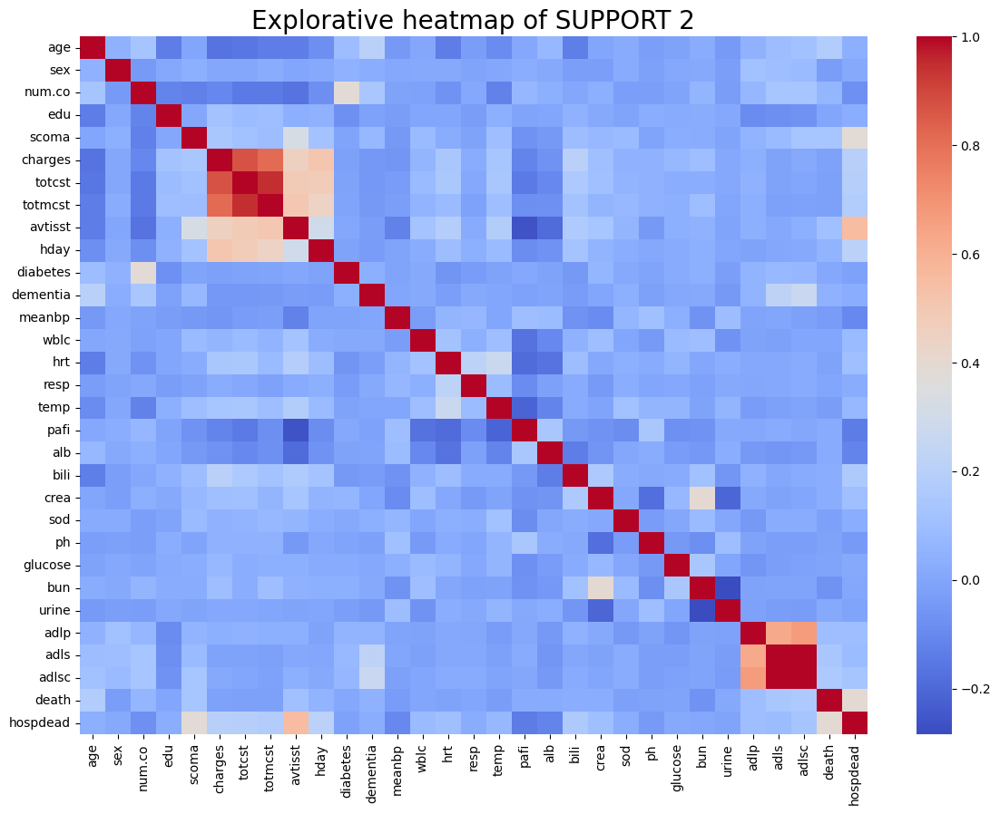

In [37]:
# Explorative heatmap with all the features, with
# the exception of the removed one in the point: REMARK 2.
# No target is still declared, and no categorical variables is
# converted yet, this plot gives a simple overview on 
# data distribution and correlation
plt.figure(figsize=(14, 10))
sns.heatmap(dataset.corr(numeric_only=True), cmap="coolwarm", annot=False)
plt.title("Explorative heatmap of SUPPORT 2", fontsize=20)
plt.show();

## 2. Distribution of Variables and Relationship with '' Total ratio of costs to charges (RCC) cost '' Class <br>


> Analysing the distribution and the relationship with other variables of the variable **totcst**, feature that will be taken as target output in the linear regression notebook part

<Figure size 1000x600 with 0 Axes>

<Axes: xlabel='totcst', ylabel='Count'>

Text(0.5, 1.0, 'Distribution of Target Variable (totcst)')

Text(0.5, 0, 'totcst Value')

Text(0, 0.5, 'Frequency / Density')

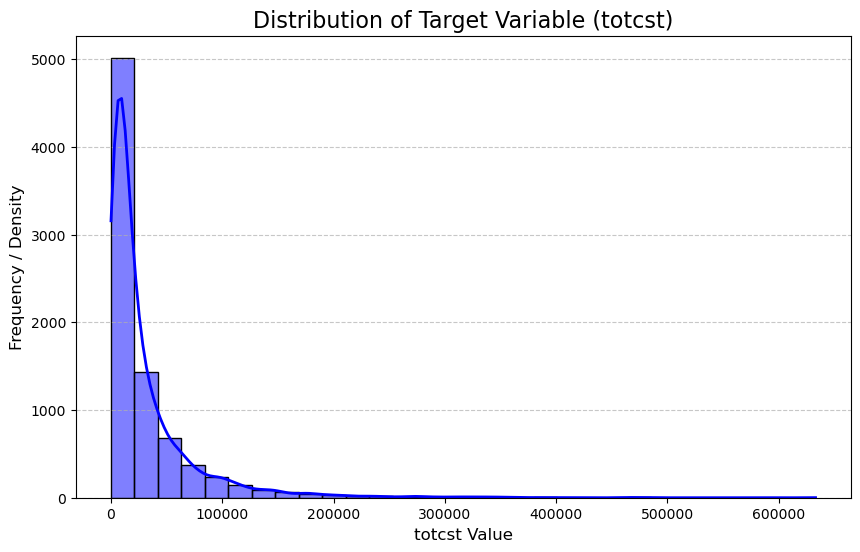


Descriptive Statistics for totcst:
count      8217.000000
mean      30825.867768
std       45780.820986
min           0.000000
25%        5929.566400
50%       14452.734400
75%       36087.937500
max      633212.000000
Name: totcst, dtype: float64


In [38]:
plt.figure(figsize=(10, 6))
sns.histplot(dataset['totcst'], kde=True, bins=30, color='blue', edgecolor='black', line_kws={'color': 'red', 'linewidth': 2})
plt.title('Distribution of Target Variable (totcst)', fontsize=16)
plt.xlabel('totcst Value', fontsize=12)
plt.ylabel('Frequency / Density', fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show();

# Some info about totcst column
print("\nDescriptive Statistics for totcst:")
print(dataset['totcst'].describe())

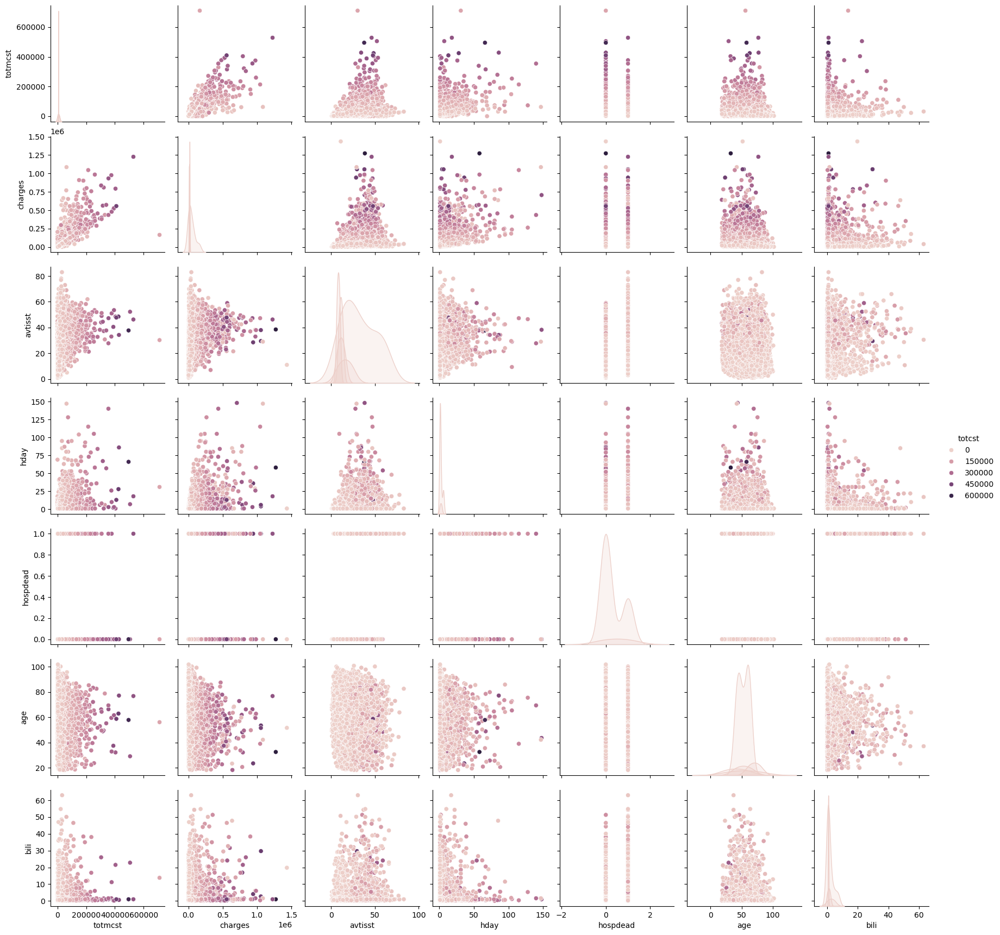

In [39]:
# Selecting the 7 most correated feature with our target
# to visualize, if present, interesting  relationships
# RCC: 'target'
corr = dataset.corr(numeric_only=True)
target_corr = corr["totcst"].abs().sort_values(ascending=False)

# top 7 corr
top_features = target_corr[1:8].index.tolist()

# Pairplot
sns.pairplot(dataset[top_features + ["totcst"]], hue='totcst')
plt.show();

we observe strong positive correlations with charges, avgilist, and hday. This indicates that higher total costs are directly associated with higher charges, longer average ICU stays, and more hospital days. Conversely, totcst shows weak or no apparent linear correlation with age and bili. The distributions for totcst, charges, avgilist, hday, and bili are notably right-skewed, suggesting a concentration of lower values and the presence of high-value outliers.

- num.co , charges, totmcst, avtisst, diabetes, bili , crea, bun, age 

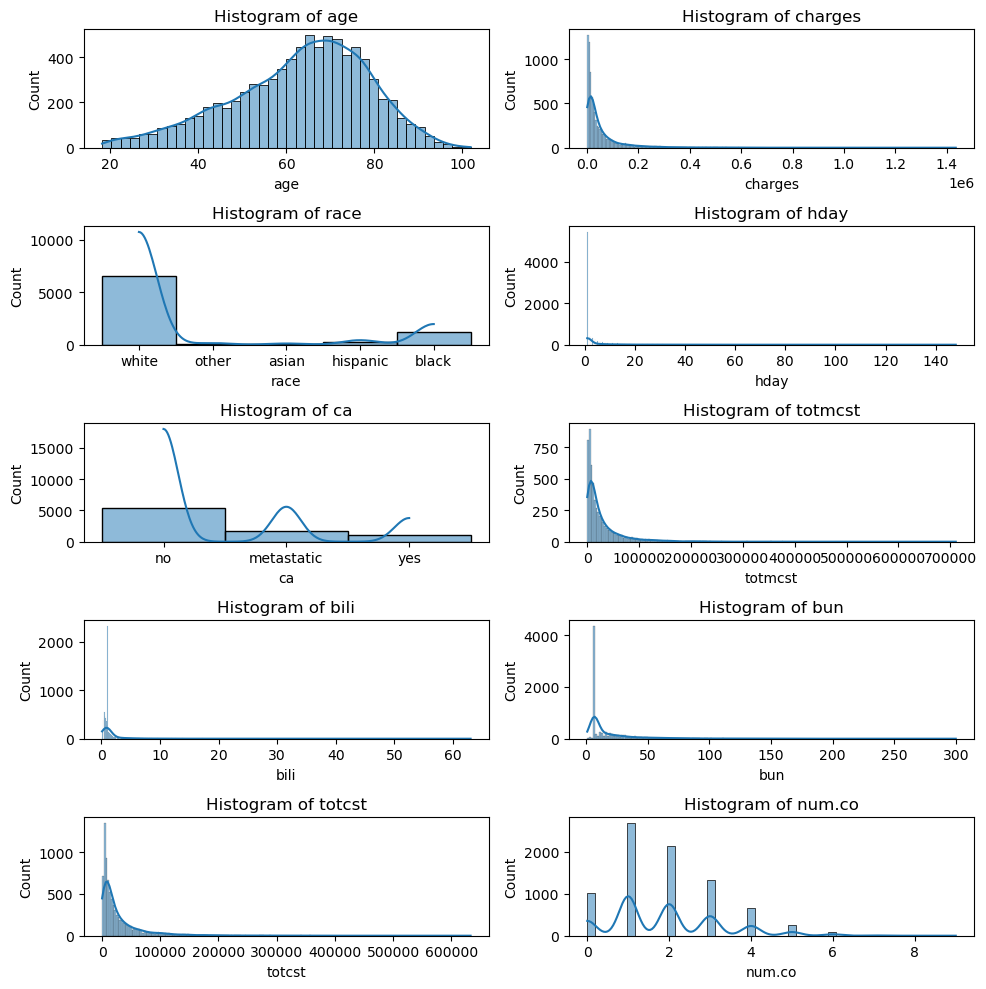

In [40]:
# Histoplot for numerical continuous variables
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(10, 10))
continuos = ['age', 'charges', 'race', 'hday', 'ca','totmcst','bili','bun','totcst', 'num.co']
for name in enumerate(continuos):
    i, name = name
    sns.histplot(data=dataset, x=name, kde=True, ax=axes[i // 2, i % 2])
    axes[i // 2, i % 2].set_title("Histogram of {}".format(name))

plt.tight_layout()
plt.show();

We observe a diverse set of distributions across the variables:

- Age: Appears normally distributed, centered around middle age.
- Charges, hday, totmcst, bili, bun, totcst: All are highly right-skewed, meaning most values are low, with a few extreme high values.
- Race, ca: Show highly imbalanced categorical distributions, with one category dominating.
- num.co: Exhibits a distinct, multi-modal distribution, typical for count data.

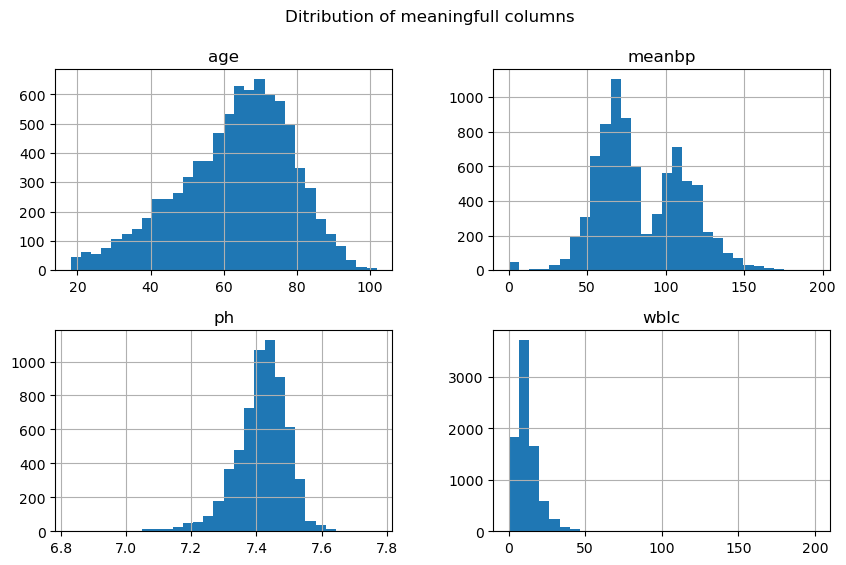

In [41]:
cols = ["age", "meanbp", "ph", "wblc"]
# wblc: counts of white blood cells
# meanbp: mean arterial blood pressure of the patient, measured at day 3.
# ph: Arterial blood pH.
dataset[cols].hist(bins=30, figsize=(10, 6))
plt.suptitle("Ditribution of meaningfull columns")
plt.show();

We observe the distributions of several meaningful columns, which we will later investigate through linear regression:

- age: The age distribution appears to be approximately normal, centered around 60-70 years, with fewer individuals at the extreme ends of the age spectrum.
- meanbp: The mean blood pressure (meanbp) shows a bimodal distribution, with two distinct peaks. One peak is around 70-80, and another, slightly lower peak, is around 100-110. This could suggest different underlying groups within the data.
- ph: The pH distribution is highly concentrated and appears to be approximately normal, centered very tightly around 7.4. This indicates a very stable and consistent measurement.
- wblc: The white blood cell count (wblc) is heavily skewed to the right, with a large number of individuals having low counts and a long tail extending to much higher values. This often indicates a baseline physiological measurement with some elevated outliers.

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">

<div align="center">

# Regression

</div>

- Develop a regression model to estimate the target variable totcst. Compare different regression algorithms for this task, and eventually perform feature selection procedures

In [42]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import train_test_split

test_size = 0.3
test_seed = 40
# Split X and y into train and test
X_train, X_test, y_train, y_test = train_test_split(X_imputed, Y, test_size=test_size, random_state=test_seed)
print("X_train.shape ", X_train.shape)
print("X_test.shape ", X_test.shape)

# This scaler transforms features by scaling each feature to a given range,
# typically between zero and one. This is crucial for models that are sensitive to the scale of input features.
scaler = MinMaxScaler()

features = X_imputed.columns

# fit on training target
y_train_scaled = scaler.fit_transform(y_train.reshape(-1,1)).ravel()
y_test_scaled = scaler.fit_transform(y_test.reshape(-1,1)).ravel()

model = LinearRegression(fit_intercept=True) # 1- hyperparams selection
model = model.fit(X_train, y_train_scaled)   # 2- model fitting

for idx, col_name in enumerate(features):
    print(f"The coefficient for {col_name} is {model.coef_[idx]:.5f}")
print(f"The intercept is {model.intercept_:.5f}")

# prediction of target
y_predict_test = model.predict(X_test)
y_predict_train = model.predict(X_train)


print("Train R2 score ", r2_score(y_train_scaled, y_predict_train))
print("Train MSE score ", mean_squared_error(y_train_scaled, y_predict_train))

print("Test R2 score ", r2_score(y_test_scaled, y_predict_test))
print("Test MSE score ", mean_squared_error(y_test_scaled, y_predict_test))

X_train.shape  (5751, 53)
X_test.shape  (2466, 53)
The coefficient for age is -0.00012
The coefficient for sex is -0.00101
The coefficient for num.co is -0.00432
The coefficient for edu is -0.00061
The coefficient for scoma is -0.00192
The coefficient for charges is 0.05433
The coefficient for totmcst is 0.03981
The coefficient for avtisst is 0.00378
The coefficient for hday is 0.00076
The coefficient for diabetes is 0.00188
The coefficient for dementia is 0.00013
The coefficient for meanbp is 0.00107
The coefficient for wblc is 0.00161
The coefficient for hrt is 0.00101
The coefficient for resp is -0.00092
The coefficient for temp is 0.00034
The coefficient for pafi is -0.00152
The coefficient for alb is -0.00135
The coefficient for bili is -0.00259
The coefficient for crea is 0.00490
The coefficient for sod is -0.00046
The coefficient for ph is 0.00029
The coefficient for glucose is -0.00144
The coefficient for bun is -0.00885
The coefficient for urine is -0.00153
The coefficient for

 ##### The following section defines several functions to perform a detailed statistical analysis of a linear regression model. This includes calculating the Residual Sum of Squares (RSS), Total Sum of Squares (TSS), and providing helper functions for multiple least squares and t testing

In [43]:
from scipy.stats import t, f

def rss(y_true, y_pred):
    # First we make sure the shapes are the same
    """
    Calculates the Residual Sum of Squares (RSS).
    RSS measures the sum of the squared differences between the actual and predicted values.
    It represents the unexplained variance by the model.
    """
    y_true = y_true.reshape(y_pred.shape)
    return np.sum((y_true - y_pred) ** 2)

def tss(y):
    """
    Calculates the Total Sum of Squares (TSS).
    TSS measures the total variation in the dependent variable (y).
    It's the sum of the squared differences between each actual value and the mean of y.
    """
    return np.sum((y - y.mean()) ** 2)

def multiple_least_squares(X, y):
    """
    A helper function that trains a Linear Regression model using scikit-learn
    and returns the coefficients (betas) and predictions. This function mimics
    the behavior of a direct implementation of least squares as the function we implemented in
    Lab02.01.
    """
    model = LinearRegression(fit_intercept=True)
    model.fit(X, y)
    y_pred = model.predict(X)
    betas = [model.intercept_, *model.coef_]
    return betas, y_pred

# Computes coefficient statistcs
def show_stats(X, y, betas, names, alpha=None):
    """
    Computes and displays statistical properties of the regression coefficients,
    including standard errors, t-statistics, and p-values.
    It can also indicate whether to reject the null hypothesis based on a given alpha level.
    """
    n_samples, n_features = X.shape
    deg = n_samples-n_features
    
    # If the ones column has not been added
    if X.shape[1] + 1 == betas.shape[0]:
        X = np.concatenate([np.ones([X.shape[0], 1]), X], axis=-1)
    
    # Compute the prediction
    pred = X.dot(betas).reshape(-1)
    betas = betas.reshape(-1)
    y = y.reshape(-1)
    RSE = ((y-pred)**2).sum()/(n_samples - n_features)

    # Compute the t statistics
    se2_b = RSE*(np.linalg.inv(np.dot(X.T, X)).diagonal())
    se_b = np.sqrt(se2_b)
    t_stat_b = (betas - 0) / se_b

    # Compute the p-value
    p_values = np.array([2*t.sf(np.abs(t_stat), deg) for t_stat in t_stat_b])
    
    df = pd.DataFrame()
    df["Name"] = names
    df["Coefficients"] = betas
    df["Standard Errors"] = se_b
    df["t-stat"] = t_stat_b
    df["p-value"] = p_values
    if alpha:
        rejectH0 = p_values < alpha
        df["reject H0"] = rejectH0    
    
    RSS = np.sum((y - pred)**2)
    MSE = RSS/y.shape[0]
    #print("RSS: {}".format(RSS))
    
    return df
 
# H0: all features in the subset are equal to 0    
def Ftest_restricted(data, y, subset_features):
    """
    Performs an F-test to compare a "complete" model with a "restricted" model.
    The null hypothesis (H0) is that the coefficients of the 'subset_features' are all zero.
    This helps in determining if the subset of features contributes to the model.
    """
    # Train the complete model
    X_complete = data.to_numpy()
    y = y.to_numpy()
    n = X_complete.shape[0]
    
    betas_complete, y_pred = multiple_least_squares(X_complete, y)    
    rss_complete = rss(y, y_pred)
    nf_complete = X_complete.shape[1]
    
    # Train the restricted model
    notS = data.columns.difference(subset_features)
    X_restr = data[notS].to_numpy()
    betas_restr, y_pred = multiple_least_squares(X_restr, y)

    rss_restr = rss(y, y_pred)
    nf_restr = X_restr.shape[1]

    q = nf_complete - nf_restr

    # Compute F statistics
    F_num = (rss_restr - rss_complete) / q
    F_den = rss_complete / (n - nf_complete - 1)
    F = F_num / F_den

    # Compute the p-value
    p_value = f.sf(F, q, n - nf_complete - 1)
    return p_value, F

betas = np.array([model.intercept_, *model.coef_]).reshape(-1, 1)
show_stats(X_train, y_train_scaled, betas, ['Intercept', *features], alpha=0.001)

C:\Users\ricca\AppData\Local\Temp\ipykernel_18552\875018012.py:56: RuntimeWarning: invalid value encountered in sqrt
  se_b = np.sqrt(se2_b)


,Name,Coefficients,Standard Errors,t-stat,p-value,reject H0
0,Intercept,6.600152e-02,0.000512,128.838042,0.000000e+00,True
1,age,-1.209933e-04,0.000579,-0.209064,8.344061e-01,False
2,sex,-1.009734e-03,0.000517,-1.951764,5.101517e-02,False
3,num.co,-4.318842e-03,0.000660,-6.547377,6.368364e-11,True
4,edu,-6.136529e-04,0.000606,-1.011855,3.116503e-01,False
5,scoma,-1.917992e-03,0.000686,-2.794460,5.216019e-03,False
6,charges,5.433152e-02,0.000875,62.074329,0.000000e+00,True
7,totmcst,3.980837e-02,0.000965,41.233288,0.000000e+00,True
8,avtisst,3.775719e-03,0.000803,4.701517,2.643199e-06,True
9,hday,7.614786e-04,0.000619,1.230545,2.185439e-01,False


<div align = 'center'>
<div style="border: 2px solid; padding: 10px; border-radius: 5px;">


# Performing an F-Test for Feature Subset Significance

>This cell performs an F-test to determine the joint significance of a specific subset of features in the linear regression model

In [44]:
from decimal import Decimal # used to see the p-value due to his very small size

alpha = 0.001
X_all_features = features
# The Ftest_restricted function expect an input data that is a Pandas
# array (since it will use strings to select the restricted model's features)
# However X_train is a numpy array. Let's convert it back to Pandas
X_train_pd = pd.DataFrame(X_train, columns=X_all_features)
y_train_pd = pd.DataFrame(y_train_scaled)

# using the significant feature
features = ['num.co', 'charges', 'totmcst', 'avtisst', 'diabetes', 'bili', 'crea', 'bun']

p_value, F = Ftest_restricted(X_train_pd, y_train_pd, features)
print("p-value < {:.1e}".format(np.finfo(float).tiny))
print("F-stat =", F)
if p_value < alpha:
    print("Reject H0: There is evidence to say that at least one of the S features is useful")
else:
    print("Do not Reject H0: There is NO evidence to say that at least one of the S features is useful")

p-value < 2.2e-308
F-stat = 2007.1063048934384
Reject H0: There is evidence to say that at least one of the S features is useful


> obtain the R2 score and the MSE for train and test

In [45]:
features = ['num.co', 'charges', 'totmcst', 'avtisst', 'diabetes', 'bili', 'crea', 'bun']

X = X_imputed[features].to_numpy()
X_train_small, X_test_small, y_train_small, y_test_small = train_test_split(X, Y,
                                                                test_size=test_size, 
                                                                random_state=test_seed)

y_train_small_scaled = scaler.fit_transform(y_train_small.reshape(-1,1)).ravel()
y_test_small_scaled = scaler.fit_transform(y_test_small.reshape(-1,1)).ravel()

model = LinearRegression()                             # 1- hyperparams selection
model = model.fit(X_train_small, y_train_scaled)       # 2- model fitting
y_predict_test = model.predict(X_test_small)           # 3- prediction
y_predict_train = model.predict(X_train_small)


print("Train R2 score ", r2_score(y_predict_train, y_train_small_scaled))
print("Train MSE score ", mean_squared_error(y_predict_train, y_train_small_scaled))

print("Test R2 score ", r2_score(y_predict_test, y_test_small_scaled))
print("Test MSE score ", mean_squared_error(y_predict_test, y_test_small_scaled))

Train R2 score  0.7996579121243366
Train MSE score  0.001488327304516722
Test R2 score  0.7969521047069916
Test MSE score  0.001576033705893515


<div style="border: 2px solid; padding: 10px; border-radius: 5px;">
<div align='center'>

## Hyperparameter Tuning with Polynomial Regression and Validation Set 


> This section of the code focuses on finding the optimal degree for PolynomialFeatures in a linear regression pipeline

Best degree:  2 
Val score:  0.8637551942155715
Test score: 0.7355303721172276


(0.0, 1.0)

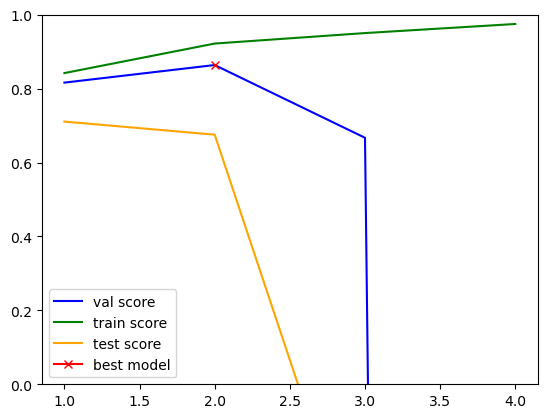

In [46]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline

# Split the previous training set into two sets: train + validation
# In this case we create a validation set having the same size of the test set
X_trainR_small, X_val_small, y_trainR, y_val = train_test_split(X_train_small, y_train_small_scaled, 
                                                                test_size=y_test_scaled.shape[0],
                                                                random_state=test_seed)

degree = list(range(1,5))
test_scores = np.zeros(len(degree))
val_scores = np.zeros(len(degree))
train_scores = np.zeros(len(degree))

# Validation
    # MinMaxScaler(): Scales features to a [0, 1] range. This is important before polynomial features
    #    to prevent features with larger scales from dominating the polynomial terms.
    # PolynomialFeatures(degree=d, include_bias=False): Transforms the input features into polynomial features
    #    up to the specified 'degree'. include_bias=False means it won't add a column of ones (intercept) here,
    #    as LinearRegression handles it.
    # LinearRegression(fit_intercept=True): The linear regression model itself, which will fit
    #    to the polynomial-transformed and scaled features. fit_intercept=True ensures an intercept term is included.
for i, d in enumerate(degree):
    
    model = make_pipeline(
        MinMaxScaler(),
        PolynomialFeatures(degree=d, include_bias=False),
        LinearRegression(fit_intercept=True)
    )
    
    model = model.fit(X_trainR_small, y_trainR)
    
    y_predict = model.predict(X_val_small)
    val_score = r2_score(y_val, y_predict)
    y_predict = model.predict(X_test_small)
    test_score = r2_score(y_test_small_scaled, y_predict)
    y_predict = model.predict(X_trainR_small)
    train_score = r2_score(y_trainR, y_predict)
    
    val_scores[i] = val_score
    test_scores[i] = test_score
    train_scores[i] = train_score

# Identifies which is the best degree
best_model_idx = np.argmax(val_scores)
best_degree = degree[best_model_idx]
# And the corresponding (best) validation score
best_val_score = val_scores[best_model_idx]
print("Best degree: ", best_degree,
      "\nVal score: ", best_val_score)

# Train again the Pipeline using the best parameter and the whole training set
model = make_pipeline(
    MinMaxScaler(),
    PolynomialFeatures(degree=best_degree, include_bias=False),
    LinearRegression(fit_intercept=True)
)

model = model.fit(X_train_small, y_train_scaled)
y_predict = model.predict(X_test_small)
test_score = r2_score(y_test_small_scaled, y_predict)

print("Test score:", test_score)

# plot
plt.ylim(0,1)
_ = plt.plot(degree, val_scores, label="val score", color="blue")
_ = plt.plot(degree, train_scores, label="train score", color="green")
_ = plt.plot(degree, test_scores, label="test score", color="orange")
_ = plt.plot([best_degree], [best_val_score], marker="x", color="red", label="best model")
plt.legend()

- Optimal Complexity: The best polynomial degree found is 2, indicating that a quadratic relationship best fits the data for generalization, as it yielded the highest validation score. <br>
<br>
- Validation Performance: With a validation R-squared score of approximately 0.864, the model shows strong performance on unseen data during hyperparameter tuning, suggesting good generalization capabilities for degree 2. <br>
<br>
- Test Set Performance: The final model achieved a test R-squared score of approximately 0.736, which is a solid performance on the completely unseen test set, confirming the model's ability to predict new outcomes. 

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">
<div align = 'center'>

# CROSS VALIDATION

> The code helps to find the best degree of a polynomial model and evaluates its performance across different stages (CV, training, and test). Instead of a single train-validation split, it utilizes K-Fold Cross-Validation on the training data

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('polynomialfeatures',
                 PolynomialFeatures(degree=1, include_bias=False)),
                ('linearregression', LinearRegression())])

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('polynomialfeatures', PolynomialFeatures(include_bias=False)),
                ('linearregression', LinearRegression())])

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('polynomialfeatures',
                 PolynomialFeatures(degree=3, include_bias=False)),
                ('linearregression', LinearRegression())])

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('polynomialfeatures',
                 PolynomialFeatures(degree=4, include_bias=False)),
                ('linearregression', LinearRegression())])

Best degree:  2 
Val score:  0.8814901805741633
Test score: 0.7355303721172276


(0.0, 1.0)

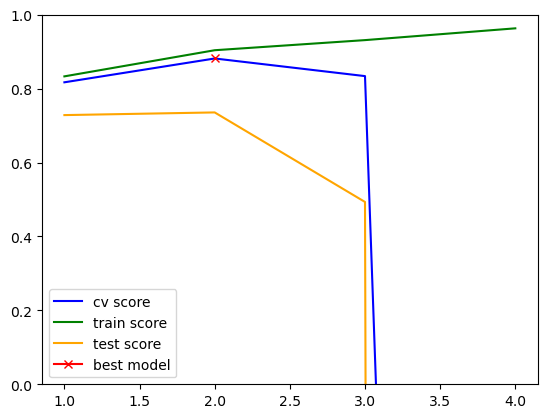

In [47]:
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer

r2_scorer = make_scorer(r2_score, greater_is_better=True)

degree = list(range(1,5))
val_scores = np.zeros(len(degree))
train_scores = np.zeros(len(degree))
test_scores = np.zeros(len(degree))
# Validation
for i, d in enumerate(degree):
    model = make_pipeline(
        MinMaxScaler(),
        PolynomialFeatures(degree=d, include_bias=False),
        LinearRegression(fit_intercept=True)
    )
    val_scores[i] = np.mean(cross_val_score(model, X_train_small, y_train_small_scaled, scoring=r2_scorer, cv=5))
    model.fit(X_train_small, y_train_small_scaled)
    train_scores[i] = r2_score(y_train_small_scaled, model.predict(X_train_small))
    test_scores[i] = r2_score(y_test_small_scaled, model.predict(X_test_small))

# Identifies which is the best degree
best_model_idx = np.argmax(val_scores)
best_degree = degree[best_model_idx]
# And the corresponding (best) validation score
best_val_score = val_scores[best_model_idx]
print("Best degree: ", best_degree,
      "\nVal score: ", best_val_score)
    
    
# Train again the Pipeline using the best parameter and the whole training set
model = make_pipeline(
    MinMaxScaler(),
    PolynomialFeatures(degree=best_degree, include_bias=False),
    LinearRegression(fit_intercept=True)
)

model = model.fit(X_train_small, y_train_small_scaled)
y_predict = model.predict(X_test_small)
test_score = r2_score(y_test_small_scaled, y_predict)

print("Test score:", test_score)

plt.ylim(0,1)
_ = plt.plot(degree, val_scores, label="cv score", color="blue")
_ = plt.plot(degree, train_scores, label="train score", color="green")
_ = plt.plot(degree, test_scores, label="test score", color="orange")
_ = plt.plot([best_degree], [best_val_score], marker="x", color="red", label="best model")
plt.legend()


We obtained a very similar, but not equal result

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">
<div align = 'center'>

## Ridge Regression

Pipeline(steps=[('minmaxscaler', MinMaxScaler()),
                ('polynomialfeatures', PolynomialFeatures(include_bias=False)),
                ('ridgecv',
                 RidgeCV(alphas=array([1.00000000e-04, 1.74332882e-04, 3.03919538e-04, 5.29831691e-04,
       9.23670857e-04, 1.61026203e-03, 2.80721620e-03, 4.89390092e-03,
       8.53167852e-03, 1.48735211e-02, 2.59294380e-02, 4.52035366e-02,
       7.88046282e-02, 1.37382380e-01, 2.39502662e-01, 4.17531894e-01,
       7.27895384e-01, 1.26896100e+00, 2.21221629e+00, 3.85662042e+00,
       6.72335754e+00, 1.17210230e+01, 2.04335972e+01, 3.56224789e+01,
       6.21016942e+01, 1.08263673e+02, 1.88739182e+02, 3.29034456e+02,
       5.73615251e+02, 1.00000000e+03]),
                         cv=5, scoring='r2'))])

Best alpha: 0.0001
Test R² score: 0.7358053228157739


(0.0, 1.0)

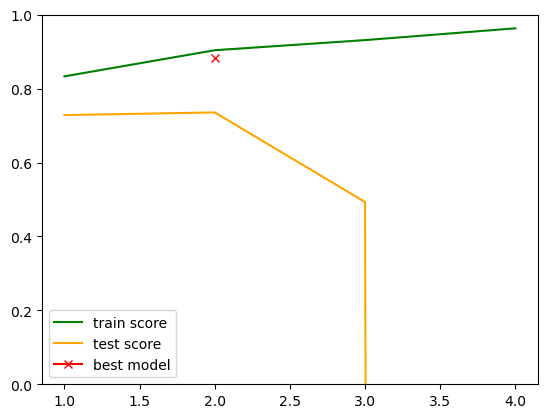

In [48]:
from sklearn.linear_model import RidgeCV

# Define candidate alpha values (log scale is usually effective)
alphas = np.logspace(-4, 3, 30)

model = make_pipeline(
    MinMaxScaler(),
    PolynomialFeatures(degree=2, include_bias=False),
    RidgeCV(alphas=alphas, scoring='r2', cv=5)
)

model.fit(X_train_small, y_train_small_scaled)
y_pred = model.predict(X_test_small)
test_score = r2_score(y_test_small_scaled, y_pred)

print("Best alpha:", model.named_steps['ridgecv'].alpha_)
print("Test R² score:", test_score)


plt.ylim(0,1)
_ = plt.plot(degree, train_scores, label="train score", color="green")
_ = plt.plot(degree, test_scores, label="test score", color="orange")
_ = plt.plot([best_degree], [best_val_score], marker="x", color="red", label="best model")
plt.legend()

The RidgeCV model with the selected best alpha (0.0001) achieved a marginally higher R-squared score on the test set compared to the plain LinearRegression model (0.7358 vs 0.7355). While the improvement is very slight, it indicates that Ridge regularization, even with a very small alpha, did not degrade the performance and might have offered a tiny bit more robustness or slightly better generalization for this specific test set.

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">

<div align="center">

# Feature Selection

</div>

> We performed feature selection, that is the process of choosing a subset of relevant features (variables, predictors) from the original data to be used in model construction.

In [49]:
import itertools # efficient tools for working with iterators

X_train_pd = pd.DataFrame(X_train, columns=X_all_features)
X_test_pd = pd.DataFrame(X_test, columns=X_all_features)

def get_subsets(X_pd, dim):
    feature_names = X_pd.columns.tolist()
    # compute all possibile combinations of 'dim' values
    subset_names = itertools.combinations(feature_names, dim) # list of list of names [[name of first candidate, ...], [...]]
    # Convert names into datasets
    data_subsets = [X_pd[list(fnames)] for fnames in subset_names]
    return data_subsets

subsets = get_subsets(X_train_pd, 2)
subsets[0].head() # training set of the first subset
subsets[1].head() # training set of the second subset

,age,sex
6297,-0.043925,-0.883022
4182,-0.291305,1.132475
5070,0.122752,-0.883022
5933,-0.748547,-0.883022
3657,-1.416678,1.132475


,age,num.co
6297,-0.043925,0.812657
4182,-0.291305,-0.666817
5070,0.122752,-0.666817
5933,-0.748547,-0.666817
3657,-1.416678,-0.666817


# Implement a Function to Perform Subset Selection

In [50]:
from sklearn.dummy import DummyRegressor

def get_evaluator(scorer):
    def evaluator(model, X, y, trained=False):
        if not trained:
            model = model.fit(X, y) #train model on the data
        score = scorer(model, X, y) # compute score on the training data
        return model, score
    return evaluator    


def subset_selection(Xtrain_pd, ytrain, Xtest_pd, ytest,
                     candidates_evaluator, candidates_argbest,
                     subsets_evaluator, subsets_argbest,       
                     test_evaluator=None, test_argbest=None,   # Metric to be used on the test set
                     candidates_scorer_name=None,             
                     subsets_scorer_name=None,                
                     verbose=True, weight_step3=0):  
    test_evaluator = subsets_evaluator if not test_evaluator else test_evaluator
    test_argbest = subsets_argbest if not test_argbest else test_argbest
    
    # Global variable init
    num_features = Xtrain_pd.shape[-1]
    best_candidate_metric = []
    # subsets_* are lists containing one value for each Mk model (the best of the Mk candidates)
    subsets_test = [] 
    subsets_metric = []        # The best metric of each subset of dimension 'dim'
    subsets_best_features = [] # The best features combination in each subset of dimension 'dim'
    # A figure to keep track of candidates scores in each Mk subset
    plt.figure()
    candidate_fig = plt.subplot(111) # A global matplotlib figure
    num_evaluations = 0              # A counter to keep track of the total number of trials
    
    for dim in range(0, 4):
        candidate_metrics = [] # Keep track of candidates metrics. Will be used to select the best
        candidate_models = []  # Keep track of candidates trained models
        
        # Fixed the number of features 'dim', look at
        # all the possible candidate models with that cardinality
        dim_subsets = get_subsets(Xtrain_pd, dim)
        # for all the possible candidates compute the performance using the specific number of features
        for Xtrain_sub in dim_subsets:
            
            # Train the model on the subset
            if Xtrain_sub.shape[-1] == 0:
                # Train the M0 model if the number of
                model = DummyRegressor()
            else:
                model = LinearRegression(fit_intercept=True)
            
            model, score = candidates_evaluator(model, Xtrain_sub, ytrain)
            candidate_models.append(model)
            candidate_metrics.append(score)
            num_evaluations += 1
            
        _ = candidate_fig.scatter([dim]*len(candidate_metrics), candidate_metrics,
                                  color="b")
            
        # select the best candidate 
        idx_best_candidate = candidates_argbest(candidate_metrics)
        # Save best candidate features
        best_features = dim_subsets[idx_best_candidate].columns.tolist()
        best_candidate_metric.append(candidate_metrics[idx_best_candidate])
        subsets_best_features.append(best_features)
        
        # Compute metric
        best_subset_model = candidate_models[idx_best_candidate]
        best_subset_Xtrain = dim_subsets[idx_best_candidate]
        _, score = subsets_evaluator(best_subset_model, best_subset_Xtrain, ytrain, trained=True)
        subsets_metric.append(score)
        best_subset_Xtest =  Xtest_pd[best_subset_Xtrain.columns.tolist()]
        _, score = test_evaluator(best_subset_model, best_subset_Xtest, ytest, trained=True)
        subsets_test.append(score)
        num_evaluations += weight_step3
        
        if verbose:
            print("............")
            print("Best model (M{}) with {} features: {}".format(dim, dim, best_features))
            print("M{} subset score (3.): {}".format(dim, score))
        
    # among all best candidates with increasing number
    # of features, select the best one
    best_subset_idx = subsets_argbest(subsets_metric)
    best_features = subsets_best_features[best_subset_idx]
    
    if verbose:
        print("\n\nBest configuration has {} features".format(best_subset_idx))
        print("Features: {}".format(subsets_best_features[best_subset_idx]))
        print("Total number of trained models:", num_evaluations)
    
    # Complete the subsets_fig figure by plotting
    # a line connecting all best candidate score
    best_candidate_score_idx = candidates_argbest(best_candidate_metric)
    _ = candidate_fig.plot(range(len(best_candidate_metric)), best_candidate_metric)
    _ = candidate_fig.scatter(best_candidate_score_idx, best_candidate_metric[best_candidate_score_idx],
                              marker='X', label="Best", color="r")
    candidate_fig.set_title(candidates_scorer_name)
    candidate_fig.legend()
    
    # Plot a figure to show how the metric evolves
    plt.figure()
    subsets_fig = plt.subplot(111)
    _ = subsets_fig.plot(range(len(subsets_metric)), subsets_metric, label="Selection (3.) scores")
    _ = subsets_fig.scatter(best_subset_idx, subsets_metric[best_subset_idx],
                              marker='X', label="Best (3.) score", color="r")
    best_test_score_idx = test_argbest(subsets_test)
    _ = subsets_fig.plot(range(len(subsets_test)), subsets_test, label="Test scores")
    _ = subsets_fig.scatter(best_test_score_idx, subsets_test[best_test_score_idx],
                              marker='X', label="Best test score", color="y")
    subsets_fig.set_title(subsets_scorer_name)
    subsets_fig.legend()

............
Best model (M0) with 0 features: []
M0 subset score (3.): 0.006040129201922318
............
Best model (M1) with 1 features: ['charges']
M1 subset score (3.): 0.002539768752533836
............
Best model (M2) with 2 features: ['charges', 'totmcst']
M2 subset score (3.): 0.0015995185597112243
............
Best model (M3) with 3 features: ['charges', 'totmcst', 'bun']
M3 subset score (3.): 0.001578435668865581


Best configuration has 3 features
Features: ['charges', 'totmcst', 'bun']
Total number of trained models: 24858


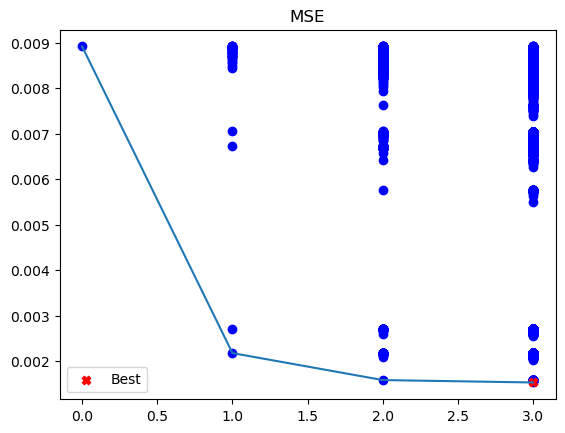

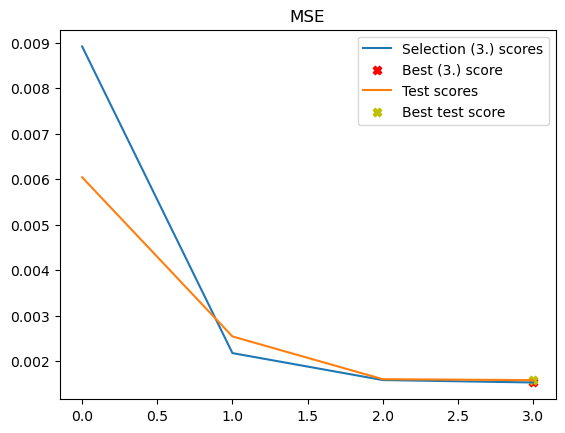

In [51]:
subset_selection(X_train_pd, y_train_scaled, X_test_pd, y_test_scaled,
                 get_evaluator(make_scorer(mean_squared_error)), np.argmin,
                 get_evaluator(make_scorer(mean_squared_error)), np.argmin,
                 candidates_scorer_name="MSE",
                 subsets_scorer_name="MSE",
                 verbose=True)

> The best subset selection process was carried out using three iterations due to the high computational cost observed when increasing to four the best subset selection. The selection was based on minimizing the Mean Squared Error (MSE). Starting with zero features, each iteration added one feature to identify the optimal combination. The final and best model includes three features: charges, totmcst, and bun, reaching the lowest validation MSE of approximately 0.00158. The corresponding test set performance confirms the model’s generalization capability, all confirmed by th etwo plots. A total of 24,858 models were trained during the search.

............
Best model (M0) with 0 features: []
M0 subset score (3.): 2326110925.848438
............
Best model (M1) with 1 features: ['charges']
M1 subset score (3.): 726010113.6927483
............
Best model (M2) with 2 features: ['charges', 'totmcst']
M2 subset score (3.): 409408600.3801825
............
Best model (M3) with 3 features: ['charges', 'totmcst', 'bun']
M3 subset score (3.): 399255625.5184522


Best configuration has 3 features
Features: ['charges', 'totmcst', 'bun']
Total number of trained models: 24858


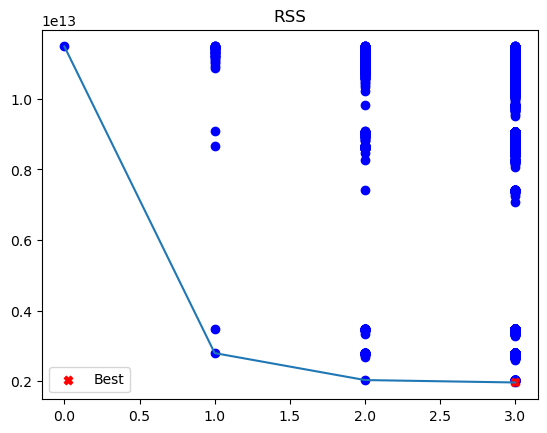

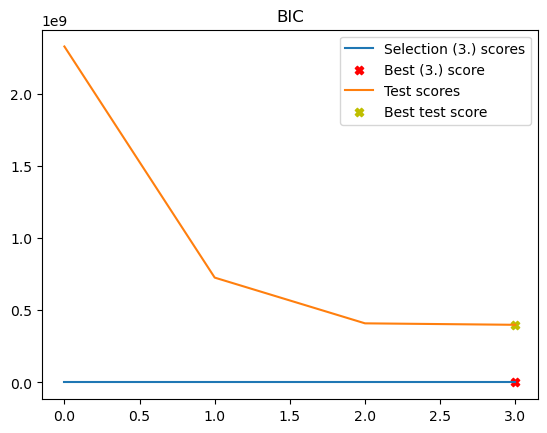

In [52]:
# Sigma scorer
def estimate_sigma(Xtrain_pd, ytrain):
    """
    Estimates the Residual Standard Error (RSE).
    It's calculated as the square root of the Residual Sum of Squares (RSS)
    divided by the residual degrees of freedom (n - p), where n is the number of samples
    and p is the number of features in the full model.
    """
    n, p = Xtrain_pd.shape
    model = LinearRegression(fit_intercept=True)
    model.fit(Xtrain_pd, ytrain)
    y_pred = model.predict(Xtrain_pd)
    RSS = rss(y_pred, ytrain)
    RSE = np.sqrt(RSS / (n-p))
    return RSE

def cp(y_pred, y_true, n, d, sigma):
    """
    Calculates Mallows' Cp statistic.
    Cp = (RSS + 2 * d * sigma^2) / n
    Where:
    RSS = Residual Sum of Squares
    d = number of features (parameters) in the current model
    sigma^2 = estimated variance of the errors (from the full model)
    n = number of samples
    """
    sigma2 = sigma**2
    return (rss(y_pred, y_true) + 2*d*sigma2) / n

def aic(y_pred, y_true, n, d, sigma):
    """
    Calculates the Akaike Information Criterion (AIC).
    AIC = (RSS + 2 * d * sigma^2) / (n * sigma^2) or n * log(RSS/n) + 2d
    Aims to minimize information loss.
    """
    sigma2 = sigma**2
    return (rss(y_pred, y_true) + 2*d*sigma2) / (n*sigma2)

def bic(y_pred, y_true, n, d, sigma):
    """
    Calculates the Bayesian Information Criterion (BIC).
    BIC = (RSS + log(n) * d * sigma^2) / (n * sigma^2) or n * log(RSS/n) + log(n) * d
    Similar to AIC but applies a stronger penalty for model complexity (log(n) vs 2).
    It tends to favor simpler models.
    """
    sigma2 = sigma**2
    return (rss(y_pred, y_true) + np.log(n)*d*sigma2) / (n*sigma2)

def adj_r2(y_pred, y_true, n, d, sigma):
    """
    Calculates the Adjusted R-squared.
    Adjusted R^2 = 1 - [(1 - R^2) * (n - 1) / (n - d - 1)]
    This metric adjusts R-squared for the number of predictors in the model,
    penalizing models with unnecessary features.
    """
    sigma2 = sigma**2
    RSS = rss(y_pred, y_true)
    TSS = tss(y_true)
    return 1 - (RSS/(n-d-1)) / (TSS/(n-1))

def get_sigma_scorer(metric, sigma):
    """
    This function allows custom metrics (like Cp, AIC, BIC) that depend on 'sigma'
    and model predictions to be used with scikit-learn's model selection tools.
    The returned scorer function takes 'model', 'X', and 'y' as input.
    """
    def scorer(model, X, y):
        n, d = X.shape
        y_pred = model.predict(X)
        return metric(y_pred, y, n, d, sigma)
    
    return scorer

sigma = estimate_sigma(X_train_pd, y_train)
subset_selection(X_train_pd, y_train, X_test_pd, y_test,
                 get_evaluator(make_scorer(rss)), np.argmin, # 2.
                 get_evaluator(get_sigma_scorer(bic, sigma)), np.argmin, # 3.
                 get_evaluator(make_scorer(mean_squared_error)), np.argmin, # test
                 candidates_scorer_name="RSS",
                 subsets_scorer_name="BIC",
                 verbose=True)

> Now the best subset selection procedure was conducted using sigma score as the evaluation metric. As before due to computational limits, the process was limited to three iterations. Starting from a baseline model with no predictors, each iteration added one feature, resulting in a substantial drop in the sigma score. The best-performing model includes three features: charges, totmcst, and bun, with a final sigma score of approximately 399 million, compared to over 2.3 billion for the null model. In total, 24,858 models were trained and assessed to identify this optimal configuration. The plots help to understand the 

<div align = 'center'>

# Forward Feature Selection

In [53]:
from sklearn.base import clone
from sklearn.model_selection import KFold

# AIC / BIC
def compute_aic(n, rss, k):
    return n * np.log(rss / n) + 2 * k

def compute_bic(n, rss, k):
    return n * np.log(rss / n) + k * np.log(n)

# Forward Stepwise Selection
def forward_stepwise_selection(X, y, model=None, 
                               max_features=None, 
                               scoring='r2', 
                               use_criterion=None,  # 'aic', 'bic', or None
                               cv=5, 
                               verbose=True):
    """
    Forward Stepwise Feature Selection with optional AIC/BIC and cross-validation.
    """
    if model is None:
        model = LinearRegression()

    if max_features is None:
        max_features = X.shape[1]

    selected_features = []
    remaining_features = list(X.columns)
    score_history = []
    raw_criterion_history = []

    kf = KFold(n_splits=cv, shuffle=True, random_state=42)
    prev_score = -np.inf  # for early stopping

    for step in range(max_features):
        best_score = -np.inf
        best_feature = None
        best_scores = []
        best_raw_criterion = None

        for feature in remaining_features:
            trial_features = selected_features + [feature]
            X_sub = X[trial_features]
            fold_scores = []
            raw_criteria = []

            for train_idx, val_idx in kf.split(X_sub):
                X_train, X_val = X_sub.iloc[train_idx], X_sub.iloc[val_idx]
                y_train, y_val = y[train_idx], y[val_idx]

                m = clone(model)
                m.fit(X_train, y_train)
                y_pred = m.predict(X_val)

                if use_criterion in ['aic', 'bic']:
                    rss = np.sum((y_val - y_pred) ** 2)
                    k_params = X_train.shape[1] + 1
                    n_samples = len(y_val)
                    if use_criterion == 'aic':
                        raw = compute_aic(n_samples, rss, k_params)
                    else:
                        raw = compute_bic(n_samples, rss, k_params)
                    score = -raw
                    raw_criteria.append(raw)
                else:
                    score = r2_score(y_val, y_pred) if scoring == 'r2' else scoring(y_val, y_pred)

                fold_scores.append(score)

            avg_score = np.mean(fold_scores)

            if avg_score > best_score:
                best_score = avg_score
                best_feature = feature
                best_scores = fold_scores
                if use_criterion in ['aic', 'bic']:
                    best_raw_criterion = np.mean(raw_criteria)

        if best_feature is None:
            break

        # Early stopping if selection criterion worsens
        if use_criterion in ['aic', 'bic'] and best_score < prev_score:
            if verbose:
                print("Early stopping: selection criterion deteriorated.")
            break
        prev_score = best_score

        selected_features.append(best_feature)
        remaining_features.remove(best_feature)
        score_history.append((best_score, np.std(best_scores)))
        if use_criterion in ['aic', 'bic']:
            raw_criterion_history.append(best_raw_criterion)

        if verbose:
            print(f"Model with {step+1} features: '{selected_features}', avg score = {best_score:.4f}")

    return selected_features, score_history, raw_criterion_history


def plot_forward_selection(scores, metric_name='Score'):
    '''
    Plot the forward selection
    '''
    means = [s[0] for s in scores]
    stds = [s[1] for s in scores]
    plt.figure(figsize=(8, 5))
    plt.errorbar(range(1, len(means) + 1), means, yerr=stds, fmt='-o')
    plt.xlabel("Number of Selected Features")
    if metric_name.lower() in ['aic', 'bic']:
        plt.ylabel(f"-{metric_name.upper()} (higher = better)")
    else:
        plt.ylabel(metric_name)
    plt.title(f"Forward Selection - {metric_name}")
    plt.grid(True)
    plt.tight_layout()
    plt.show();

def plot_raw_criterion(values, criterion='aic'):
    '''
    Plot the raw criterion
    '''
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, len(values)+1), values, marker='o')
    plt.xlabel("Number of Selected Features")
    plt.ylabel(f"{criterion.upper()} (lower = better)")
    plt.title(f"Forward Selection - Raw {criterion.upper()} Criterion")
    plt.grid(True)
    plt.tight_layout()
    plt.show();

Model with 1 features: '['totmcst']', avg score = 3237.5569
Model with 2 features: '['totmcst', 'charges']', avg score = 3433.4618
Model with 3 features: '['totmcst', 'charges', 'bun']', avg score = 3446.6879
Model with 4 features: '['totmcst', 'charges', 'bun', 'crea']', avg score = 3450.1494
Model with 5 features: '['totmcst', 'charges', 'bun', 'crea', 'wblc']', avg score = 3452.2278
Early stopping: selection criterion deteriorated.


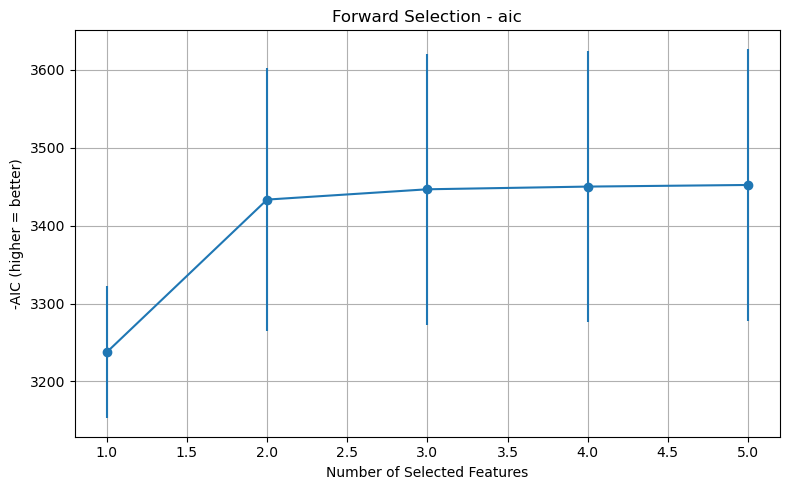

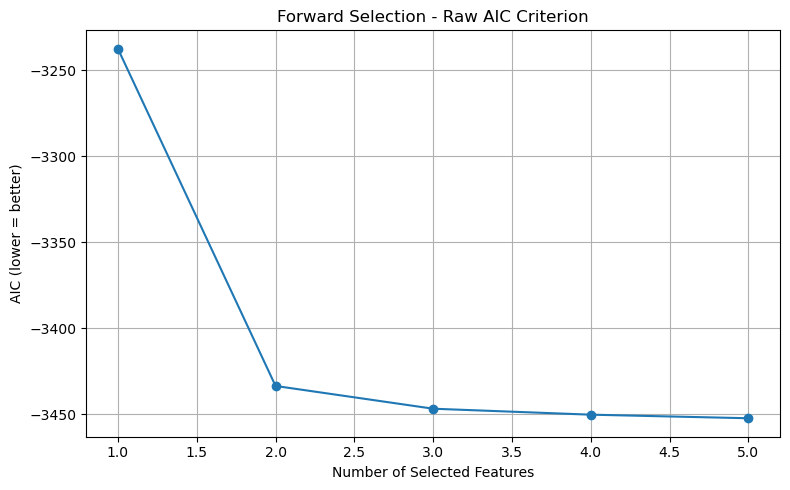

LinearRegression()


      Final Model Results
Selected features based on AIC: ['totmcst', 'charges', 'bun', 'crea', 'wblc']
Final Model R-squared: 0.7301


In [54]:
aic_features, aic_scores, aic_values = forward_stepwise_selection(X_test, y_test_scaled, use_criterion='aic', cv=5)
plot_forward_selection(aic_scores, metric_name="aic")
plot_raw_criterion(aic_values, criterion='aic')

# --- Final Model Evaluation ---
# 1. Select the final features from the training and test sets
final_X_train = X_train[aic_features]
final_X_test = X_test[aic_features]

# 2. Create and train the final linear regression model
final_model = LinearRegression()
final_model.fit(final_X_train, y_train_scaled)

# 3. Make predictions on the test set
y_pred_scaled = final_model.predict(final_X_test)

# 4. Calculate the R-squared score on the scaled test data
r2_final = r2_score(y_test_scaled, y_pred_scaled)

# --- Output ---
print("\n" + "="*30)
print("      Final Model Results")
print("="*30)
print(f"Selected features based on AIC: {aic_features}")
print(f"Final Model R-squared: {r2_final:.4f}")
print("="*30)

> A forward selection procedure was applied using AIC as the selection criterion, aiming to maximize model quality while penalizing complexity. The plots show that the positive AIC (−AIC) increases significantly( and decrease when using raw AIC-criterion)when moving from one to two features, and stabilizes afterward, indicating diminishing gains from adding more predictors. The optimal model selected five features: totmcst, charges, bun, crea, and wblc. The final model achieved an R-squared of 0.7301, suggesting strong explanatory power. The relatively flat curve beyond 3 features implies that a simpler model with fewer variables could offer a comparable trade-off between accuracy and parsimony.

<div align = 'center'>

## Backward Stepwise Selection

In [55]:
#model evaluation with cross-validation
def _evaluate_model_with_cv(X, y, features, model_instance, cv_folds, scoring, use_criterion):
    """
    Evaluates a model with a given set of features using cross-validation.
    """
    if not features:
        # If no features are selected, return a very poor score
        # (inf for raw criterion, -inf for maximized score)
        return -np.inf, 0.0, float('inf')

    fold_scores = []
    raw_criterion_values = []
    
    for train_idx, val_idx in cv_folds.split(X[features]):
        X_train, X_val = X.iloc[train_idx][features], X.iloc[val_idx][features]
        y_train, y_val = y.iloc[train_idx], y.iloc[val_idx]

        m = clone(model_instance) # Clone the model for each fold to ensure fresh state
        m.fit(X_train, y_train)
        y_pred = m.predict(X_val)

        if use_criterion in ['aic', 'bic']:
            rss = np.sum((y_val - y_pred) ** 2)
            k_params = X_train.shape[1] + 1 # +1 for intercept
            n_samples = len(y_val)
            raw_criterion = compute_aic(n_samples, rss, k_params) if use_criterion == 'aic' else compute_bic(n_samples, rss, k_params)
            raw_criterion_values.append(raw_criterion)
            score = -raw_criterion # Maximize negative AIC/BIC for consistency with R2 (higher is better)
        else:
            score = r2_score(y_val, y_pred)
        
        fold_scores.append(score)
    
    mean_score = np.mean(fold_scores)
    std_score = np.std(fold_scores) if len(fold_scores) > 1 else 0.0 # Handle single fold case
    mean_raw_criterion = np.mean(raw_criterion_values) if raw_criterion_values else None

    return mean_score, std_score, mean_raw_criterion

# Backward Stepwise Selection (Corrected)
def backward_stepwise_selection(X, y, model=None,
                                min_features=1,
                                scoring='r2',
                                use_criterion=None,  # 'aic', 'bic', or None
                                cv=5,
                                verbose=True):
    """
    Backward Stepwise Feature Selection. Iteratively removes features to find the
    best model based on the chosen criterion (R-squared, AIC, or BIC).
    """
    if model is None:
        model = LinearRegression()

    selected_features = list(X.columns)
    history = [] # Stores {'num_features', 'mean_score', 'std_score', 'raw_criterion'} for each step
    kf = KFold(n_splits=cv, shuffle=True, random_state=42)

    best_score_so_far = -np.inf # Stores the best (maximized) score found across all steps
    best_feature_set_so_far = selected_features.copy() # Stores the features corresponding to best_score_so_far
    
    current_num_features = len(X.columns) # Start with all features
    
    # --- Main backward elimination loop ---
    # Loop continues as long as the current number of features is greater than or equal to min_features.
    while current_num_features >= min_features:
        if verbose:
            print(f"\n--- Evaluating model with {current_num_features} features ---")

        # Evaluate the current set of selected features (before considering removal for next step)
        current_mean_score, current_std_score, current_raw_criterion = \
            _evaluate_model_with_cv(X, y, selected_features, model, kf, scoring, use_criterion)
        
        # Store current model's performance in history
        history.append({
            'num_features': current_num_features,
            'mean_score': current_mean_score,
            'std_score': current_std_score,
            'raw_criterion': current_raw_criterion
        })

        if verbose:
            score_type_str = f"Negative {use_criterion.upper()}" if use_criterion else scoring.upper()
            print(f"Features: {selected_features}")
            print(f"Model Performance ({score_type_str}): {current_mean_score:.4f} (Std Dev: {current_std_score:.4f})")
            if use_criterion:
                print(f"Raw {use_criterion.upper()}: {current_raw_criterion:.4f} (lower is better)")

        # Update the globally best model found so far
        # We are maximizing the score (R2 or negative AIC/BIC)
        if current_mean_score > best_score_so_far:
            best_score_so_far = current_mean_score
            best_feature_set_so_far = selected_features.copy()

        # If we have reached the minimum desired number of features, stop the loop.
        if current_num_features == min_features:
            break

        # --- Find the feature to remove for the next iteration ---
        feature_to_remove_this_step = None
        # Initialize with a very low score to ensure any valid score is better
        best_score_after_removal = -np.inf 
        
        # Iterate through each feature in the currently selected set
        # and evaluate the model if that feature were removed.
        for feature_candidate in selected_features:
            trial_features = [f for f in selected_features if f != feature_candidate]
            
            # Evaluate the model with the trial set of features
            trial_mean_score, _, _ = \
                _evaluate_model_with_cv(X, y, trial_features, model, kf, scoring, use_criterion)
            
            # If removing this feature results in a better score, update
            if trial_mean_score > best_score_after_removal:
                best_score_after_removal = trial_mean_score
                feature_to_remove_this_step = feature_candidate
        
        # Remove the chosen feature from the selected set for the next iteration
        if feature_to_remove_this_step:
            selected_features.remove(feature_to_remove_this_step)
            current_num_features -= 1
            if verbose:
                print(f"Step Summary: Removed '{feature_to_remove_this_step}'. Next model will have {current_num_features} features.")
        else:
            # This case should ideally not be reached before min_features is met,
            # unless no single feature removal improves the score beyond -np.inf.
            if verbose:
                print("No feature removal improved the model score or min_features reached. Stopping.")
            break

    if verbose:
        print("\n" + "="*30)
        print("Backward Selection Complete.")
        print(f"The best model found has {len(best_feature_set_so_far)} features.")
        score_name_final = f"Negative {use_criterion.upper()}" if use_criterion else scoring.upper()
        print(f"Best Score ({score_name_final}): {best_score_so_far:.4f}")
        print("="*30)

    # Return the overall best feature set found and the complete history for plotting
    return best_feature_set_so_far, history

# --- Plotting functions (Updated to use history data) ---
def plot_backward_selection(history_data, metric_name='Score'):
    """
    Plots the mean score and standard deviation of models at each step of backward selection.
    """
    # Sort history data by number of features for correct plotting order (ascending)
    history_data_sorted = sorted(history_data, key=lambda x: x['num_features'])

    num_features = [d['num_features'] for d in history_data_sorted]
    means = [d['mean_score'] for d in history_data_sorted]
    stds = [d['std_score'] for d in history_data_sorted]

    plt.figure(figsize=(10, 6))
    # Plot number of features on X-axis, scores on Y-axis
    plt.errorbar(num_features, means, yerr=stds, fmt='-o', capsize=5, label='Mean Score +/- Std Dev', color='blue')
    
    plt.xlabel("Number of Selected Features")
    y_label_text = ""
    if metric_name.lower() in ['aic', 'bic']:
        y_label_text = f"Negative {metric_name.upper()} (higher = better)"
    else:
        y_label_text = metric_name.capitalize()
    plt.ylabel(y_label_text)
    
    plt.title(f"Backward Selection - Model Performance by Number of Features ({metric_name})")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

def plot_raw_criterion_backward(history_data, criterion='aic'):
    """
    Plots the raw information criterion values (AIC or BIC) at each step of backward selection.
    """
    # Filter out entries where raw_criterion is None or infinite, and sort by number of features
    history_data_filtered_sorted = sorted(
        [d for d in history_data if d['raw_criterion'] is not None and not np.isinf(d['raw_criterion'])],
        key=lambda x: x['num_features']
    )

    num_features = [d['num_features'] for d in history_data_filtered_sorted]
    raw_values = [d['raw_criterion'] for d in history_data_filtered_sorted]

    plt.figure(figsize=(10, 6))
    plt.plot(num_features, raw_values, marker='o', linestyle='-', color='red')
    
    plt.xlabel("Number of Selected Features")
    plt.ylabel(f"Raw {criterion.upper()} (lower = better)")
    plt.title(f"Backward Selection - Raw {criterion.upper()} Criterion by Number of Features")
    plt.grid(True)
    plt.tight_layout()
    plt.show();


--- Evaluating model with 53 features ---
Features: ['age', 'sex', 'num.co', 'edu', 'scoma', 'charges', 'totmcst', 'avtisst', 'hday', 'diabetes', 'dementia', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 'bili', 'crea', 'sod', 'ph', 'glucose', 'bun', 'urine', 'adlp', 'adls', 'adlsc', 'death', 'hospdead', 'dzgroup_CHF', 'dzgroup_COPD', 'dzgroup_Cirrhosis', 'dzgroup_Colon Cancer', 'dzgroup_Coma', 'dzgroup_Lung Cancer', 'dzgroup_MOSF w/Malig', 'dzclass_COPD/CHF/Cirrhosis', 'dzclass_Cancer', 'dzclass_Coma', 'income_$25-$50k', 'income_>$50k', 'income_under $11k', 'race_black', 'race_hispanic', 'race_other', 'race_white', 'ca_no', 'ca_yes', 'sfdm2_Coma or Intub', 'sfdm2_SIP>=30', 'sfdm2_adl>=4 (>=5 if sur)', 'sfdm2_no(M2 and SIP pres)']
Model Performance (Negative AIC): 3347.3699 (Std Dev: 174.3247)
Raw AIC: -3347.3699 (lower is better)
Step Summary: Removed 'hday'. Next model will have 52 features.

--- Evaluating model with 52 features ---
Features: ['age', 'sex', 'num.co', 'edu

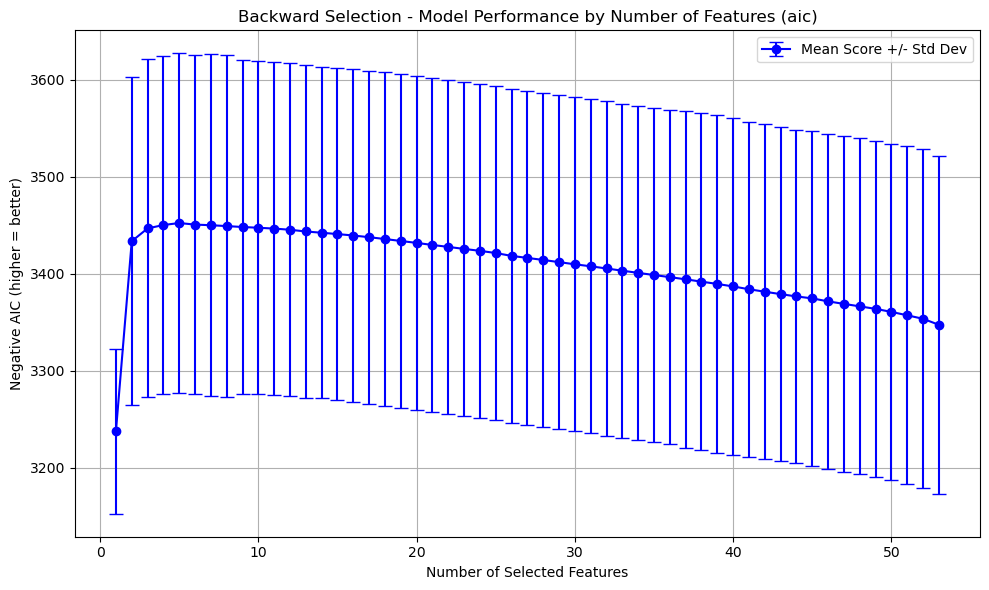

LinearRegression()


      Final Model Results
Selected features based on AIC: ['charges', 'totmcst', 'wblc', 'crea', 'bun']
Final Model R-squared: 0.7301


In [56]:
aic_features, aic_scores = backward_stepwise_selection(pd.DataFrame(X_test), pd.DataFrame(y_test_scaled), use_criterion="aic", cv=5)
plot_backward_selection(aic_scores, metric_name="aic")
#plot_raw_criterion_backward(aic_values, criterion='aic')

# --- Final Model Evaluation ---
# 1. Select the final features from the training and test sets
final_X_train = X_train[aic_features]
final_X_test = X_test[aic_features]

# 2. Create and train the final linear regression model
final_model = LinearRegression()
final_model.fit(final_X_train, y_train_scaled)

# 3. Make predictions on the test set
y_pred_scaled = final_model.predict(final_X_test)

# 4. Calculate the R-squared score on the scaled test data
r2_final = r2_score(y_test_scaled, y_pred_scaled)

# --- Output ---
print("\n" + "="*30)
print("      Final Model Results")
print("="*30)
print(f"Selected features based on AIC: {aic_features}")
print(f"Final Model R-squared: {r2_final:.4f}")
print("="*30)

> The figure illustrates the backward feature selection process based on the Akaike Information Criterion (AIC). The model performance improves significantly as features are removed, reaching its optimal point with only 5 predictors. The selected features: `charges`, `totmcst`, `wblc`, `crea`, and `bun`, yield the best trade-off between model simplicity and performance, achieving an R² of 0.7301. This suggests that a small subset of clinically and economically relevant variables can effectively predict the outcome in the SUPPORT2 dataset.

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">
<div align="center">

# CLASSIFICATION

</div>

We developed a classification model to predict whether the patient has died by
 the end of 1994, identified with a domain analysis which information can
 represent the target variable for this task. Then compared different classification
 models, choosing the appropriate metrics

In [57]:
data = dataset.copy()
columns_convert = ['sex', 'hospdead', 'diabetes', 'dementia','dzclass','income','race','ca','sfdm2']
data_target = pd.get_dummies(data, columns=columns_convert, drop_first = True)
data_target["death"] = data_target["death"].astype(int)
data_target.head()

,age,dzgroup,num.co,edu,scoma,charges,totcst,totmcst,avtisst,hday,...,race_black,race_hispanic,race_other,race_white,ca_no,ca_yes,sfdm2_Coma or Intub,sfdm2_SIP>=30,sfdm2_adl>=4 (>=5 if sur),sfdm2_no(M2 and SIP pres)
14,43.53998,ARF/MOSF w/Sepsis,1,NaN,26.0,706577.0,390460.5000,NaN,38.250000,148,...,False,False,False,True,True,False,False,True,False,False
17,63.66299,ARF/MOSF w/Sepsis,0,22.0,26.0,283303.0,156674.1250,NaN,40.000000,13,...,False,False,False,True,True,False,False,False,False,False
18,31.84399,Cirrhosis,2,16.0,0.0,27985.0,17528.4375,NaN,10.000000,1,...,False,False,False,True,True,False,False,False,False,False
21,48.70398,Lung Cancer,0,16.0,0.0,55384.0,33002.5000,NaN,9.666664,1,...,False,False,True,False,False,False,False,False,False,False
22,49.61298,ARF/MOSF w/Sepsis,1,12.0,0.0,542266.0,288592.2500,NaN,33.750000,29,...,False,False,False,True,True,False,False,False,True,False


> Dropped the columns death because is our target of interest, glucose for the high level of missing values (>>50%), dzgroup because wa have already dzclass to represent the information and education has been dropped because the conversion gave back too much dummy variables making the computation too heavy, also it seems that is not so much correlated variables

In [58]:
X = data_target.drop(["death",'glucose','edu', 'dzgroup'], axis = 1) ###edu 
y = data_target["death"]

Once dropped the columns the imputation could be performed, scaling first the values to enhance the performance of the kNN since it is sensitive to distance.

In [59]:
X = data_target.drop(["death",'glucose','edu', 'dzgroup'], axis = 1) ###edu 
y = data_target["death"]
# Scale since knn uses distances
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)

# Impute values
imputer = KNNImputer(n_neighbors=5)
X_imputed = imputer.fit_transform(X_scaled)

# replace missing values with imputed
X_imputed = pd.DataFrame(X_imputed, columns=X.columns)
X_imputed.isnull().sum()

X_imputed.head()

age                           0
num.co                        0
scoma                         0
charges                       0
totcst                        0
totmcst                       0
avtisst                       0
hday                          0
meanbp                        0
wblc                          0
hrt                           0
resp                          0
temp                          0
pafi                          0
alb                           0
bili                          0
crea                          0
sod                           0
ph                            0
bun                           0
urine                         0
adlp                          0
adls                          0
adlsc                         0
sex_1                         0
hospdead_1                    0
diabetes_1                    0
dementia_1                    0
dzclass_COPD/CHF/Cirrhosis    0
dzclass_Cancer                0
dzclass_Coma                  0
income_$

,age,num.co,scoma,charges,totcst,totmcst,avtisst,hday,meanbp,wblc,...,race_black,race_hispanic,race_other,race_white,ca_no,ca_yes,sfdm2_Coma or Intub,sfdm2_SIP>=30,sfdm2_adl>=4 (>=5 if sur),sfdm2_no(M2 and SIP pres)
0,0.303610,0.111111,0.26,0.491829,0.616635,0.080272,0.454268,1.000000,0.343590,0.122988,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
1,0.543946,0.000000,0.26,0.196711,0.247428,0.075664,0.475610,0.081633,0.353846,0.150488,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0.163922,0.222222,0.00,0.018697,0.027682,0.029821,0.109756,0.000000,0.425641,0.025000,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
3,0.365286,0.000000,0.00,0.037800,0.052119,0.006556,0.105691,0.000000,0.338462,0.062500,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.376142,0.111111,0.00,0.377267,0.455759,0.170799,0.399390,0.190476,0.343590,0.055000,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0


Compute the number of dead patient until 1994, the alive patients and the percentage of death.

In [60]:
dead = np.sum(y == 1)
alive = np.sum(y == 0)
print(f"Total number of deatd patient until 1994: {dead}")
print(f"Total number of alive patient: {alive}")
percentage_of_death = dead/(dead + alive)
print(f"% of death: {percentage_of_death}")

Total number of deatd patient until 1994: 5645
Total number of alive patient: 2572
% of death: 0.6869903857855665


Use the mean to impute the numeric columns.

In [61]:
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy="mean")  #Can also use 'median'| 'most_frequent'
X_imputed = pd.DataFrame(imputer.fit_transform(X), columns=X.columns)

# Normalize the numeric columns
numeric_cols = X_imputed.select_dtypes(include=[np.number]).columns.tolist()  
scaler = MinMaxScaler()
X_imputed[numeric_cols] = scaler.fit_transform(X_imputed[numeric_cols])
X_imputed.head()

,age,num.co,scoma,charges,totcst,totmcst,avtisst,hday,meanbp,wblc,...,race_black,race_hispanic,race_other,race_white,ca_no,ca_yes,sfdm2_Coma or Intub,sfdm2_SIP>=30,sfdm2_adl>=4 (>=5 if sur),sfdm2_no(M2 and SIP pres)
0,0.303610,0.111111,0.26,0.491829,0.616635,0.040704,0.454268,1.000000,0.343590,0.122988,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
1,0.543946,0.000000,0.26,0.196711,0.247428,0.040704,0.475610,0.081633,0.353846,0.150488,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
2,0.163922,0.222222,0.00,0.018697,0.027682,0.040704,0.109756,0.000000,0.425641,0.025000,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
3,0.365286,0.000000,0.00,0.037800,0.052119,0.040704,0.105691,0.000000,0.338462,0.062500,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.376142,0.111111,0.00,0.377267,0.455759,0.040704,0.399390,0.190476,0.343590,0.055000,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0


<div align="center">

# LOGISTIC REGRESSION

This relation may not seem linear at first glance. However, we require the model to be linear because its **decision boundary** is linear. Actually, we just need that a **linear monotone transformation of the posterior probabilities $P(Y|X)$ exists for the model to be linear**.

Here, the monotone transformation is the **logit** transformation $log[p/(1-p)]$:
$\quad log\left( \frac{P(Y=1|X)}{P(Y=0|X)} \right) = \beta_0 + \beta_1^T X$

The **decision  boundary** is the set of points for which the **log-odds** are zero

In [ ]:
from sklearn.linear_model import LogisticRegressionCV
from sklearn.model_selection import RepeatedKFold
from sklearn.feature_selection import RFE
 
# Data Preprocessing
## already done -> uncomment if need a check
#imputer = SimpleImputer(strategy="mean")
# X_imputed = pd.DataFrame(imputer.fit_transform(X), columns=X.columns)

# Recursive Feature Elimination for Feature Selection
# The solver 'newton-cg' is generally robust for L2 penalty.
base_model_for_rfe = LogisticRegression(solver='newton-cholesky', penalty="l2", random_state=0)

kept_features_by_count = []
# Iterate from 1 feature up to the total number of features
# to find the best subset based on accuracy.
for i in range(1, len(X_imputed.columns) + 1):
    # RFE recursively removes features and fits the model.
    # verbose=False suppresses detailed output during fitting.
    rfe = RFE(estimator=base_model_for_rfe, n_features_to_select=i, verbose=False)
    # Fit RFE on the entire imputed dataset.
    rfe.fit(X_imputed, y)
    # Get the names of the features kept in the current iteration.
    kept_feat = X_imputed.columns[rfe.support_]
    kept_features_by_count.append(kept_feat)

# Evaluate Feature Subsets using Cross-Validation
accuracy_scores_per_feature_count = []
# Loop through each set of features identified by RFE
for j, features_subset in enumerate(kept_features_by_count):
    # Subset the data with the current set of features
    X_current_subset = X_imputed[features_subset]

    # Create a pipeline for Logistic Regression:
    # 1. StandardScaler: Scales features (important for L2 regularization).
    #    Scale within the CV loop to prevent data leakage.
    # 2. LogisticRegressionCV: Performs internal 5-fold CV to select the
    #    best 'C' parameter for L2 regularization.
    model_pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('logreg_cv', LogisticRegressionCV(
            cv=5,                # Internal cross-validation folds for C selection
            random_state=0,      # For reproducibility
            solver='newton-cholesky',  # Solver for logistic regression
            penalty="l2",        # L2 regularization
            n_jobs=-1            # Use all available CPU cores
        ))
    ])

    # Evaluate the pipeline using external 5-fold cross-validation.
    # This assesses how well the model generalizes.
    outer_cv = KFold(n_splits=5, random_state=0, shuffle=True)
    # Use the pipeline directly with cross_val_score.
    current_scores = cross_val_score(model_pipeline, X_current_subset, y, cv=outer_cv, n_jobs=-1, scoring='accuracy')

    # Store the mean accuracy for the current feature subset.
    accuracy_scores_per_feature_count.append(np.mean(current_scores))

# Select the Best Features
# Find the index of the feature count that yielded the highest mean accuracy.
max_accuracy_index = np.argmax(accuracy_scores_per_feature_count)
best_features_LogReg = kept_features_by_count[max_accuracy_index]

# Retrieve the highest accuracy found during feature selection evaluation.
max_accuracy_during_selection = accuracy_scores_per_feature_count[max_accuracy_index]

# Final Model Evaluation using Repeated K-Fold Cross-Validation
# Evaluate the performance of the Logistic Regression model using the
# best_features_LogReg.

final_model_pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('logreg_cv', LogisticRegressionCV(
        cv=5,                # Internal CV for C selection (can be adjusted if needed)
        random_state=0,      # For reproducibility of C selection
        solver='newton-cholesky',
        penalty="l2",
        n_jobs=-1
    ))
])

accuracy_list_logistic = []
sensitivity_list_logistic = [] 
precision_list_logistic = []

num_repetitions = 30 

for i in range(num_repetitions):
    cv_repetition = KFold(n_splits=5, random_state=i, shuffle=True)

    # Calculate accuracy
    accuracy = cross_val_score(final_model_pipeline, X_imputed[best_features_LogReg], y,
                               scoring='accuracy', cv=cv_repetition, n_jobs=-1)
    accuracy_list_logistic.append(np.mean(accuracy))

    # Calculate sensitivity (recall)
    sensitivity = cross_val_score(final_model_pipeline, X_imputed[best_features_LogReg], y,
                                  scoring='recall', cv=cv_repetition, n_jobs=-1)
    sensitivity_list_logistic.append(np.mean(sensitivity))

    # Calculate precision
    precision = cross_val_score(final_model_pipeline, X_imputed[best_features_LogReg], y,
                                scoring='precision', cv=cv_repetition, n_jobs=-1)
    precision_list_logistic.append(np.mean(precision))

# Report Final Results
mean_accuracy_logistic = np.mean(accuracy_list_logistic)
mean_sensitivity_logistic = np.mean(sensitivity_list_logistic)
mean_precision_logistic = np.mean(precision_list_logistic)

print("--- Logistic Regression Model Analysis ---")
print(f"\nThe best features selected for the Logistic Regression model are (total: {len(best_features_LogReg)}):")
print(list(best_features_LogReg))

print(f"\nMaximum mean accuracy achieved during feature selection: {max_accuracy_during_selection:.4f}")

print("\n--- Final Model Performance (averaged over 30 repetitions) ---")
print(f"Accuracy: {mean_accuracy_logistic:.4f}")
print(f"Sensitivity (Recall): {mean_sensitivity_logistic:.4f}")
print(f"Precision: {mean_precision_logistic:.4f}")
print("\nNote: Sensitivity (Recall) is the ability of the model to correctly identify all relevant instances (true positives).")
print("Precision is the ability of the model to return only relevant instances (true positives).")
print("These metrics are particularly useful if the dataset is imbalanced.")

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=1, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=2, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=3, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=4, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=5, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=6, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=7, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=8, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=9, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=10, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=11, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=12, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=13, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=14, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=15, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=16, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=17, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=18, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=19, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=20, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=21, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=22, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=23, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=24, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=25, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=26, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=27, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=28, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=29, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=30, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=31, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=32, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=33, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=34, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=35, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=36, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=37, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=38, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=39, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=40, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=41, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=42, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=43, verbose=False)

RFE(estimator=LogisticRegression(random_state=0, solver='newton-cholesky'),
    n_features_to_select=44, verbose=False)

--- Logistic Regression Model Analysis ---

The best features selected for the Logistic Regression model are (total: 40):
['age', 'num.co', 'scoma', 'charges', 'totcst', 'totmcst', 'avtisst', 'hday', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 'bili', 'crea', 'sod', 'ph', 'bun', 'urine', 'adlp', 'adls', 'sex_1', 'hospdead_1', 'diabetes_1', 'dzclass_COPD/CHF/Cirrhosis', 'dzclass_Cancer', 'income_$25-$50k', 'income_>$50k', 'income_under $11k', 'race_black', 'race_other', 'race_white', 'ca_no', 'ca_yes', 'sfdm2_Coma or Intub', 'sfdm2_SIP>=30', 'sfdm2_adl>=4 (>=5 if sur)', 'sfdm2_no(M2 and SIP pres)']

Maximum mean accuracy achieved during feature selection: 0.7919

--- Final Model Performance (averaged over 30 repetitions) ---
Accuracy: 0.7907
Sensitivity (Recall): 0.8580
Precision: 0.8407

Note: Sensitivity (Recall) is the ability of the model to correctly identify all relevant instances (true positives).
Precision is the ability of the model to return only relevant instances

<div align="center">

# LDA - Linear Discriminant Analysis

> After computing the Logistic Regression, go on with Linear Discriminant Analysis and Quadratic Discrimininat Anaysis to see if there is an improvement in the performance.

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA

# Recursive Feature Elimination (RFE) for Feature Selection 
base_model_for_rfe_lda = LDA(solver="lsqr", shrinkage="auto")

kept_features_by_count_lda = []
# Iterate from 1 feature up to the total number of features
#to find the best subset based on cross-validated accuracy.
for i in range(1, len(X_imputed.columns) + 1):
    # RFE recursively removes features and fits the model.
    rfe_lda = RFE(estimator=base_model_for_rfe_lda, n_features_to_select=i, verbose=False)
    # Fit RFE on the entire imputed dataset.
    rfe_lda.fit(X_imputed, y)
    # Get the names of the features kept in the current iteration.
    kept_feat = X_imputed.columns[rfe_lda.support_]
    kept_features_by_count_lda.append(kept_feat)

# Evaluate Feature Subsets using Cross-Validation
# To find the optimal number of features for LDA, we evaluate each subset
# identified by RFE using a cross-validated LDA model.

accuracy_scores_per_feature_count_lda = []
# Loop through each set of features identified by RFE
for j, features_subset in enumerate(kept_features_by_count_lda):
    # Subset the data with the current set of features
    X_current_subset = X_imputed[features_subset]

    # Create a pipeline for LDA:
    # 1. StandardScaler: Scales features. Essential for many models and good practice.
    #    It's crucial to scale within the CV loop to prevent data leakage.
    # 2. LDA: The Linear Discriminant Analysis model.
    model_pipeline_lda = Pipeline([
        ('scaler', StandardScaler()),
        ('lda', LDA(solver="lsqr", shrinkage="auto")) # Use the same LDA parameters
    ])

    # Evaluate the pipeline using external 5-fold cross-validation.
    outer_cv_lda = KFold(n_splits=5, random_state=0, shuffle=True)
    # Use the pipeline directly with cross_val_score.
    current_scores_lda = cross_val_score(model_pipeline_lda, X_current_subset, y,
                                         cv=outer_cv_lda, n_jobs=-1, scoring='accuracy')

    # Store the mean accuracy for the current feature subset.
    accuracy_scores_per_feature_count_lda.append(np.mean(current_scores_lda))

# Select the Best Features
max_accuracy_index_lda = np.argmax(accuracy_scores_per_feature_count_lda)
best_features_lda = kept_features_by_count_lda[max_accuracy_index_lda]

# Retrieve the highest accuracy found during feature selection evaluation.
max_accuracy_during_selection_lda = accuracy_scores_per_feature_count_lda[max_accuracy_index_lda]

# Final Model Evaluation using Repeated K-Fold Cross-Validation
# Now, evaluate the performance of the LDA model using the
# best_features_lda over multiple random splits (30 iterations) for
# a more robust estimate of the model's true generalization performance.

# Initialize the final LDA pipeline.
final_model_pipeline_lda = Pipeline([
    ('scaler', StandardScaler()),
    ('lda', LDA(solver="lsqr", shrinkage="auto"))
])

accuracy_list_LDA = []
sensitivity_list_LDA = [] # Sensitivity is also known as Recall
precision_list_LDA = []

num_repetitions = 30 # Number of times to repeat the cross-validation

for i in range(num_repetitions):
    # Use KFold with different random_state for each repetition for varied shuffles.
    cv_repetition_lda = KFold(n_splits=5, random_state=i, shuffle=True)

    # Calculate accuracy
    accuracy = cross_val_score(final_model_pipeline_lda, X_imputed[best_features_lda], y,
                               scoring='accuracy', cv=cv_repetition_lda, n_jobs=-1)
    accuracy_list_LDA.append(np.mean(accuracy))

    # Calculate sensitivity (recall)
    sensitivity = cross_val_score(final_model_pipeline_lda, X_imputed[best_features_lda], y,
                                  scoring='recall', cv=cv_repetition_lda, n_jobs=-1)
    sensitivity_list_LDA.append(np.mean(sensitivity))

    # Calculate precision
    precision = cross_val_score(final_model_pipeline_lda, X_imputed[best_features_lda], y,
                                scoring='precision', cv=cv_repetition_lda, n_jobs=-1)
    precision_list_LDA.append(np.mean(precision))

#report Final Result
# Calculate the overall mean of the metrics across all repetitions.
mean_accuracy_LDA = np.mean(accuracy_list_LDA)
mean_sensitivity_LDA = np.mean(sensitivity_list_LDA)
mean_precision_LDA = np.mean(precision_list_LDA)

print("--- Linear Discriminant Analysis (LDA) Model Analysis ---")
print(f"\nThe best features selected for the LDA model are (total: {len(best_features_lda)}):")
print(list(best_features_lda))

print(f"\nMaximum mean accuracy achieved during feature selection: {max_accuracy_during_selection_lda:.4f}")

print("\n--- Final Model Performance (averaged over 30 repetitions) ---")
print(f"Accuracy: {mean_accuracy_LDA:.4f}")
print(f"Sensitivity (Recall): {mean_sensitivity_LDA:.4f}")
print(f"Precision: {mean_precision_LDA:.4f}")
print("\nNote: Sensitivity (Recall) is the ability of the model to correctly identify all relevant instances (true positives).")
print("Precision is the ability of the model to return only relevant instances (true positives).")
print("These metrics are particularly useful if the dataset is unbalanced.")


RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=1, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=2, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=3, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=4, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=5, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=6, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=7, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=8, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=9, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=10, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=11, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=12, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=13, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=14, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=15, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=16, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=17, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=18, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=19, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=20, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=21, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=22, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=23, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=24, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=25, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=26, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=27, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=28, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=29, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=30, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=31, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=32, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=33, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=34, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=35, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=36, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=37, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=38, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=39, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=40, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=41, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=42, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=43, verbose=False)

RFE(estimator=LinearDiscriminantAnalysis(shrinkage='auto', solver='lsqr'),
    n_features_to_select=44, verbose=False)

--- Linear Discriminant Analysis (LDA) Model Analysis ---

The best features selected for the LDA model are (total: 37):
['age', 'num.co', 'scoma', 'charges', 'totcst', 'totmcst', 'avtisst', 'hday', 'meanbp', 'wblc', 'hrt', 'resp', 'temp', 'pafi', 'alb', 'bili', 'crea', 'sod', 'ph', 'bun', 'urine', 'adlp', 'adls', 'adlsc', 'sex_1', 'hospdead_1', 'dzclass_COPD/CHF/Cirrhosis', 'dzclass_Cancer', 'dzclass_Coma', 'income_under $11k', 'race_other', 'ca_no', 'ca_yes', 'sfdm2_Coma or Intub', 'sfdm2_SIP>=30', 'sfdm2_adl>=4 (>=5 if sur)', 'sfdm2_no(M2 and SIP pres)']

Maximum mean accuracy achieved during feature selection: 0.7864

--- Final Model Performance (averaged over 30 repetitions) ---
Accuracy: 0.7851
Sensitivity (Recall): 0.8486
Precision: 0.8402

Note: Sensitivity (Recall) is the ability of the model to correctly identify all relevant instances (true positives).
Precision is the ability of the model to return only relevant instances (true positives).
These metrics are particularly use

<div align="center">

# QDA - Quadratic Discriminant Analysis

In [ ]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis as QDA
from sklearn.feature_selection import SelectKBest, f_classif # Using f_classif for numerical features
import warnings

# Suppress specific UserWarnings
# The collinearity warning for QDA is acknowledged.
warnings.simplefilter(action='ignore', category=UserWarning)

# Feature Selection using SelectKBest
# Select the top 'k' features based on a statistical test.
# Using f_classif (ANOVA F-value) which is suitable for numerical features
# and a classification target. If your features are predominantly
# non-negative categorical, chi2 might be more appropriate.
kept_features_by_count_qda = []
for k_val in range(1, len(X_imputed.columns) + 1):
    # SelectKBest with f_classif selects features based on ANOVA F-value.
    selector = SelectKBest(f_classif, k=k_val)
    # Fit and transform the data to get the selected subset.
    X_selected_subset = selector.fit_transform(X_imputed, y)
    # Get the names of the selected features.
    selected_indices = selector.get_support(indices=True)
    selected_features_names = X_imputed.columns[selected_indices]
    kept_features_by_count_qda.append(selected_features_names)

print("Note on QDA and Collinearity: Quadratic Discriminant Analysis assumes that each class has its " \
        "own Gaussian distribution and covariance matrix. High collinearity among features can lead to singular covariance matrices, " \
        "making the model unstable or unable to fit correctly. While SelectKBest helps reduce dimensionality, it does not directly address" \
        " collinearity. We are proceeding acknowledging this potential issue for classification purposes.")

# Evaluate Feature Subsets using Cross-Validation
# To find the optimal number of features for QDA, we evaluate each subset
# identified by SelectKBest using a cross-validated QDA model.

accuracy_scores_per_feature_count_qda = []
# Loop through each set of features identified by SelectKBest
for j, features_subset in enumerate(kept_features_by_count_qda):
    # Subset the data with the current set of features
    X_current_subset = X_imputed[features_subset]

    # Create a pipeline for QDA:
    # 1. StandardScaler: Scales features. This is crucial for numerical stability
    #    of the covariance matrix estimation in QDA
    # 2. QDA: The Quadratic Discriminant Analysis model.
    model_pipeline_qda = Pipeline([
        ('scaler', StandardScaler()),
        ('qda', QDA()) # Default QDA parameters
    ])

    # Evaluate the pipeline using external 5-fold cross-validation.
    outer_cv_qda = KFold(n_splits=5, random_state=0, shuffle=True)
    #use the pipeline directly with cross_val_score.
    current_scores_qda = cross_val_score(model_pipeline_qda, X_current_subset, y,
                                         cv=outer_cv_qda, n_jobs=-1, scoring='accuracy')

    # Store the mean accuracy for the current feature subset.
    accuracy_scores_per_feature_count_qda.append(np.mean(current_scores_qda))

# Select the Best Features
# Find the index of the feature count that yielded the highest mean accuracy.
max_accuracy_index_qda = np.argmax(accuracy_scores_per_feature_count_qda)
best_features_qda = kept_features_by_count_qda[max_accuracy_index_qda]

# Retrieve the Highest accuracy found during feature selection evaluation.
max_accuracy_during_selection_qda = accuracy_scores_per_feature_count_qda[max_accuracy_index_qda]

print(f"\n--- Quadratic Discriminant Analysis (QDA) Feature Selection ---")
print(f"The best features selected for the QDA model are (total: {len(best_features_qda)}):")
print(list(best_features_qda))
print(f"Maximum mean accuracy achieved during feature selection: {max_accuracy_during_selection_qda:.4f}")

# Final Model Evaluation using Repeated K-Fold Cross-Validation
# Evaluate the performance of the QDA model using the best_features_qda
# over multiple random splits (30 repetitions) for a more robust estimate
# of the model's true generalization performance.

# Initialize the final QDA pipeline.
final_model_pipeline_qda = Pipeline([
    ('scaler', StandardScaler()),
    ('qda', QDA()) # Use the same QDA parameters
])

accuracy_list_QDA = []
sensitivity_list_QDA = []
precision_list_QDA = []
matthews_list_QDA = [] # Matthews Correlation Coefficient

num_repetitions = 30 #repeat the cross-validation

for i in range(num_repetitions):
    # Use KFold with different random_state for each repetition for varied shuffles.
    cv_repetition_qda = KFold(n_splits=5, random_state=i, shuffle=True)

    # Calculate accuracy
    accuracy = cross_val_score(final_model_pipeline_qda, X_imputed[best_features_qda], y,
                               scoring='accuracy', cv=cv_repetition_qda, n_jobs=-1)
    accuracy_list_QDA.append(np.mean(accuracy))

    # Calculate sensitivity (recall)
    sensitivity = cross_val_score(final_model_pipeline_qda, X_imputed[best_features_qda], y,
                                  scoring='recall', cv=cv_repetition_qda, n_jobs=-1)
    sensitivity_list_QDA.append(np.mean(sensitivity))

    # Calculate precision
    precision = cross_val_score(final_model_pipeline_qda, X_imputed[best_features_qda], y,
                                scoring='precision', cv=cv_repetition_qda, n_jobs=-1)
    precision_list_QDA.append(np.mean(precision))

    # Calculate Matthews Correlation Coefficient (MCC)
    # MCC is especially useful for imbalanced datasets as it considers all four
    # values in the confusion matrix
    mcc = cross_val_score(final_model_pipeline_qda, X_imputed[best_features_qda], y,
                          scoring='matthews_corrcoef', cv=cv_repetition_qda, n_jobs=-1)
    matthews_list_QDA.append(np.mean(mcc))


# Report Final Results
mean_accuracy_QDA = np.mean(accuracy_list_QDA)
mean_sensitivity_QDA = np.mean(sensitivity_list_QDA)
mean_precision_QDA = np.mean(precision_list_QDA)
mean_matthews_QDA = np.mean(matthews_list_QDA)

print("\n--- Quadratic Discriminant Analysis (QDA) Model Analysis ---")
print(f"Accuracy: {mean_accuracy_QDA:.4f}")
print(f"Sensitivity (Recall): {mean_sensitivity_QDA:.4f}")
print(f"Precision: {mean_precision_QDA:.4f}")
print(f"Matthews Correlation Coefficient (MCC): {mean_matthews_QDA:.4f}")
print("\nNote: Sensitivity (Recall) is the ability of the model to correctly identify all relevant instances (true positives).")
print("Precision is the ability of the model to return only relevant instances (true positives).")
print("MCC is a balanced metric useful for evaluating binary classifications, even on imbalanced datasets.")

Note on QDA and Collinearity: Quadratic Discriminant Analysis assumes that each class has its own Gaussian distribution and covariance matrix. High collinearity among features can lead to singular covariance matrices, making the model unstable or unable to fit correctly. While SelectKBest helps reduce dimensionality, it does not directly address collinearity. We are proceeding acknowledging this potential issue for classification purposes.

--- Quadratic Discriminant Analysis (QDA) Feature Selection ---
The best features selected for the QDA model are (total: 19):
['age', 'num.co', 'scoma', 'avtisst', 'hday', 'bun', 'adlp', 'adls', 'adlsc', 'hospdead_1', 'dementia_1', 'dzclass_COPD/CHF/Cirrhosis', 'dzclass_Cancer', 'dzclass_Coma', 'ca_no', 'ca_yes', 'sfdm2_SIP>=30', 'sfdm2_adl>=4 (>=5 if sur)', 'sfdm2_no(M2 and SIP pres)']
Maximum mean accuracy achieved during feature selection: 0.5941

--- Quadratic Discriminant Analysis (QDA) Model Analysis ---
Accuracy: 0.5748
Sensitivity (Recall): 

Note that from LDA to QDA the accuracy of the model dropped from about 0.8 to 0.576. The drop in accuracy from LDA (0.8) to QDA (0.576) suggests that the increased complexity of QDA might be detrimental to the model's performance on this specific dataset. 
<br>
<br>
The classes might not have significantly different covariance structures in the dataset, or the differences are not strong enough to be reliably captured by QDA given the amount of data or also the underlying structure of the data might conform more closely to LDA's assumption of equal covariance matrices across classes.

<div align="center">
<div style="border: 2px solid; padding: 10px; border-radius: 5px;">

# NON Parametric-Method


After performed the parametric methods, we tried with non-parametric to see if better results can be achieved.

<div align = 'center'>

## KNN - K Nearest Neighbors

The first method is the kNN, one of the simplest non parametric method based on similarity between neighbours objects.

In [65]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix, matthews_corrcoef # Added MCC

# Hyperparameter Tuning for KNN using GridSearchCV
# This ensures that feature scaling is part of the hyperparameter tuning process
knn_pipeline_for_tuning = Pipeline([
    ('scaler', StandardScaler()),              # Step 1: Scale features
    ('knn', KNeighborsClassifier())            # Step 2: KNN Classifier
])

# Define the parameter grid for n_neighbors.
param_grid_knn = {'knn__n_neighbors': np.arange(1, 51)} # Search up to 50 neighbors

# Use GridSearchCV to find the best n_neighbors.
# cv=5 means 5-fold cross-validation will be performed internally for each n_neighbors value.
grid_search_knn = GridSearchCV(knn_pipeline_for_tuning, param_grid_knn, cv=5, scoring='accuracy', n_jobs=-1, verbose=1)

# This will find the best n_neighbors based on 5-fold CV.
grid_search_knn.fit(X_imputed, y)

# Get the best number of neighbors and the best model found by GridSearchCV.
best_n_neighbors = grid_search_knn.best_params_['knn__n_neighbors']
best_knn_model = grid_search_knn.best_estimator_ # This is now the best pipeline (scaler + knn with best_n_neighbors)

print(f"--- K-Nearest Neighbors (KNN) Hyperparameter Tuning ---")
print(f"The best number of neighbors found through GridSearchCV is: {best_n_neighbors}")
print(f"Best cross-validated accuracy during tuning: {grid_search_knn.best_score_:.4f}")

# Final Model Evaluation using Repeated K-Fold Cross-Validation
# Evaluate the performance of the best KNN model (pipeline) found
# over multiple random splits for a more robust estimate
# of the model's true generalization performance.

accuracy_list_KNN = []
sensitivity_list_KNN = []
precision_list_KNN = []
matthews_list_KNN = [] 

num_repetitions = 30 #repeat the cross-validation

for i in range(num_repetitions):
    # Use KFold with different random_state for each repetition for varied shuffles.
    cv_repetition_knn = KFold(n_splits=5, random_state=i, shuffle=True)

    # Calculate accuracy
    # We use 'best_knn_model' which is the pipeline with the best n_neighbors and a scaler.
    accuracy = cross_val_score(best_knn_model, X_imputed, y,
                               scoring='accuracy', cv=cv_repetition_knn, n_jobs=-1)
    accuracy_list_KNN.append(np.mean(accuracy))

    # Calculate sensitivity
    sensitivity = cross_val_score(best_knn_model, X_imputed, y,
                                  scoring='recall', cv=cv_repetition_knn, n_jobs=-1)
    sensitivity_list_KNN.append(np.mean(sensitivity))

    # Calculate precision
    precision = cross_val_score(best_knn_model, X_imputed, y,
                                scoring='precision', cv=cv_repetition_knn, n_jobs=-1)
    precision_list_KNN.append(np.mean(precision))

    # Calculate Matthews Correlation Coefficient (MCC)
    mcc = cross_val_score(best_knn_model, X_imputed, y,
                          scoring='matthews_corrcoef', cv=cv_repetition_knn, n_jobs=-1)
    matthews_list_KNN.append(np.mean(mcc))

# report Final Results
# Calculate the overall mean of the metrics across all repetitions.
mean_accuracy_KNN = np.mean(accuracy_list_KNN)
mean_sensitivity_KNN = np.mean(sensitivity_list_KNN)
mean_precision_KNN = np.mean(precision_list_KNN)
mean_matthews_KNN = np.mean(matthews_list_KNN)

print("\n--- K-Nearest Neighbors (KNN) Model Analysis ---")
print(f"KNN model with best K = {best_n_neighbors} neighbors (averaged over {num_repetitions} repetitions):")
print(f"Accuracy: {mean_accuracy_KNN:.4f}")
print(f"Sensitivity (Recall): {mean_sensitivity_KNN:.4f}")
print(f"Precision: {mean_precision_KNN:.4f}")
print(f"Matthews Correlation Coefficient (MCC): {mean_matthews_KNN:.4f}")
print("\nNote: Sensitivity (Recall) is the ability of the model to correctly identify all relevant instances (true positives).")
print("Precision is the ability of the model to return only relevant instances (true positives).")
print("MCC is a balanced metric useful for evaluating binary classifications, even on imbalanced datasets.")


Fitting 5 folds for each of 50 candidates, totalling 250 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('knn', KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'knn__n_neighbors': array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50])},
             scoring='accuracy', verbose=1)

--- K-Nearest Neighbors (KNN) Hyperparameter Tuning ---
The best number of neighbors found through GridSearchCV is: 24
Best cross-validated accuracy during tuning: 0.7683

--- K-Nearest Neighbors (KNN) Model Analysis ---
KNN model with best K = 24 neighbors (averaged over 30 repetitions):
Accuracy: 0.7640
Sensitivity (Recall): 0.8634
Precision: 0.8067
Matthews Correlation Coefficient (MCC): 0.4303

Note: Sensitivity (Recall) is the ability of the model to correctly identify all relevant instances (true positives).
Precision is the ability of the model to return only relevant instances (true positives).
MCC is a balanced metric useful for evaluating binary classifications, even on imbalanced datasets.


>  The kNN reached an accuracy of 0.764, with a very good sensitivity for the true positives of 0.86

KNN model with 24 neighbors
Accuracy: 0.792
Misclassification rate: 0.208
Sensitivity (Recall): 0.879
Specificity (Precision): 0.829


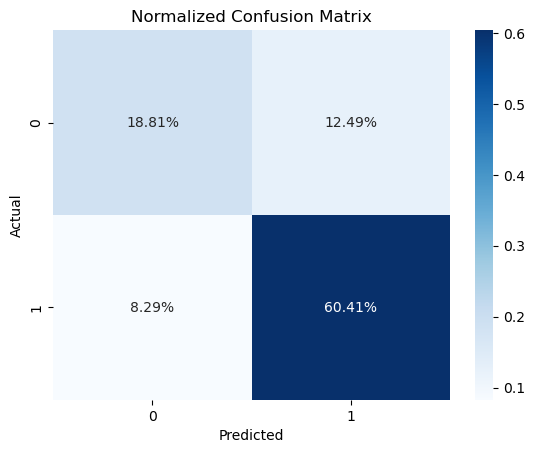

In [66]:
# Predizione
knn_pred = grid_search_knn.predict(X_imputed)

# Metriche
accuracy_knn = accuracy_score(y, knn_pred)
misclass_knn = 1 - accuracy_knn
sensitivity_knn = recall_score(y, knn_pred)
specificity_knn = precision_score(y, knn_pred)

# Output
print(f"KNN model with {best_n_neighbors} neighbors")
print(f"Accuracy: {accuracy_knn:.3f}")
print(f"Misclassification rate: {misclass_knn:.3f}")
print(f"Sensitivity (Recall): {sensitivity_knn:.3f}")
print(f"Specificity (Precision): {specificity_knn:.3f}")

# Confusion matrix
cf_matrix = confusion_matrix(y, knn_pred)
sns.heatmap(cf_matrix / np.sum(cf_matrix), annot=True, fmt='.2%', cmap='Blues')
plt.title("Normalized Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show();

The KNN model with 24 neighbors demonstrates a good overall performance, with an accuracy of 79.2%, meaning nearly four out of five predictions are correct. Its misclassification rate of 20.8% is consequently low.

The Sensitivity (Recall) of 87.9% indicates that the model is very effective at identifying actual positive cases, correctly capturing most of them. The Specificity (Precision) of 82.9% shows that when the model predicts a positive outcome, it is correct about 83% of the time, suggesting a good reliability in its positive predictions

<div align = 'center'>

## Plot all the models in order to compare them and observe the best.

C:\Users\ricca\AppData\Local\Temp\ipykernel_18552\1295434553.py:56: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('tab10', len(models_for_colors))


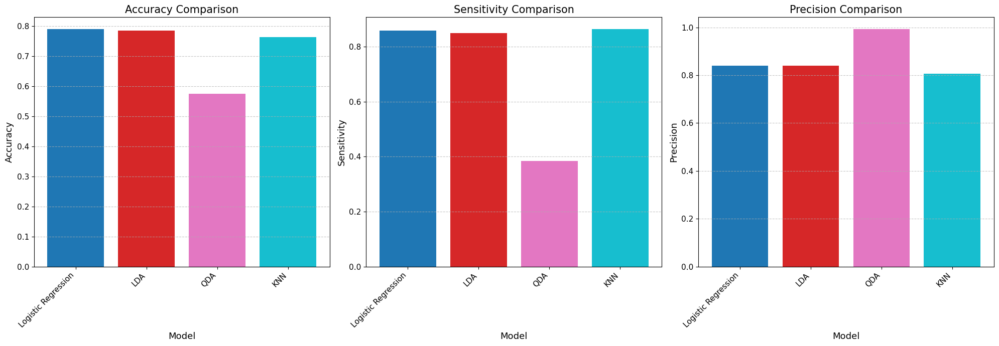

In [67]:
def get_metric_value(var_name, default_value=np.nan):
    """Safely retrieves a global variable's value or returns a default."""
    try:
        return globals()[var_name]
    except KeyError:
        print(f"Warning: Metric variable '{var_name}' not found. Using {default_value} as placeholder.")
        return default_value

model_names_list = [
    "Logistic Regression",
    "LDA",
    "QDA",
    "KNN"
]

# List of calculated accuracy values for each model
accuracies_list = [
    get_metric_value('mean_accuracy_logistic'),
    get_metric_value('mean_accuracy_LDA'),
    get_metric_value('mean_accuracy_QDA'),
    get_metric_value('mean_accuracy_KNN')
]

# List of calculated sensitivity values for each model
sensitivities_list = [
    get_metric_value('mean_sensitivity_logistic'),
    get_metric_value('mean_sensitivity_LDA'),
    get_metric_value('mean_sensitivity_QDA'),
    get_metric_value('mean_sensitivity_KNN')
]

# List of calculated precision values for each model
precisions_list = [
    get_metric_value('mean_precision_logistic'),
    get_metric_value('mean_precision_LDA'),
    get_metric_value('mean_precision_QDA'),
    get_metric_value('mean_precision_KNN')
]

# Create the DataFrame summarizing model performances
summary_df = pd.DataFrame({
    "model": model_names_list,
    "accuracy": accuracies_list,
    "sensitivity": sensitivities_list,
    "precision": precisions_list,
})

# Get unique model names for consistent coloring in plots
models_for_colors = summary_df['model'].unique()
metrics_to_plot = [
    'accuracy', 'sensitivity', 'precision'
]
fig, axes = plt.subplots(1, len(metrics_to_plot), figsize=(20, 7))
if len(metrics_to_plot) == 1:
    axes = [axes]
colors = plt.cm.get_cmap('tab10', len(models_for_colors))

for i, column in enumerate(metrics_to_plot):
    ax = axes[i] # Select the current subplot axis

    ax.bar(summary_df['model'], summary_df[column], color=[colors(j) for j in range(len(models_for_colors))])

    ax.set_xlabel('Model', fontsize=13)
    ax.set_ylabel(column.capitalize(), fontsize=13)
    ax.set_title(f'{column.capitalize()} Comparison', fontsize=15)

    # Rotate x-axis labels for better readability, especially if model names are long
    ax.set_xticklabels(summary_df['model'], rotation=45, ha='right', fontsize=11)
    ax.tick_params(axis='y', labelsize=11)
    ax.grid(axis='y', linestyle='--', alpha=0.7) # Add horizontal grid

# Adjust subplot parameters preventing labels from overlapping
plt.tight_layout()
plt.show();

The three bar plots compare the performance of our four classification models—Logistic Regression, LDA, QDA, and KNN—using three different metrics: accuracy, sensitivity, and precision. In terms of accuracy, Logistic Regression and LDA show the best results, while QDA performs the worst. KNN also demonstrates strong accuracy, slightly below the top two models. For sensitivity, KNN outperforms all others, followed by Logistic Regression and LDA, whereas QDA lags significantly behind. Interestingly, QDA achieves the highest precision despite its low accuracy and sensitivity, indicating that it makes fewer false positive errors. Logistic Regression and LDA have similar precision values, and KNN scores slightly lower in this metric. Overall, KNN delivers a well-balanced performance across all three metrics, making it the most consistent and stable classifier among the four.

The accuracy reached the peak with Logistic Regression and LDA, which also showed good sensitivity. The QDA dropped in both of them, reaching the highest precision. The knn averaged a good performance in all the results, being the most stable classifier.

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">
<div align='center'>

# ROC Curve 


In [68]:
##ROC CURVE logistic
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

> logistic roc

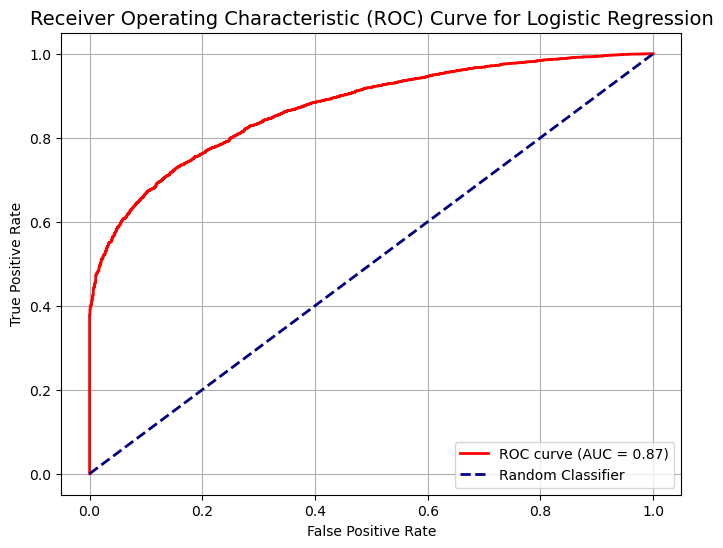

In [69]:
final_model_pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('logreg_cv', LogisticRegressionCV(
            cv=5,
            random_state=0,
            solver='newton-cholesky',
            penalty="l2",
            n_jobs=-1
        ))
    ])
# Fit the pipeline on the full data with the best selected features.
# This is the crucial step to ensure the pipeline (and its scaler) is fitted.
final_model_pipeline.fit(X_imputed[best_features_LogReg], y)

y_prob_logistic = final_model_pipeline.predict_proba(X_imputed[best_features_LogReg])[:, 1]

# Compute ROC curve values: False Positive Rate (fpr), True Positive Rate (tpr), and thresholds
fpr_logistic, tpr_logistic, thresholds_logistic = roc_curve(y, y_prob_logistic)

# Compute Area Under the Curve (AUC)
roc_auc_logistic = auc(fpr_logistic, tpr_logistic)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_logistic, tpr_logistic, color='red', lw=2,
         label='ROC curve (AUC = {:.2f})'.format(roc_auc_logistic))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for Logistic Regression', fontsize=14)
plt.legend(loc="lower right")
plt.grid(True)
plt.show();

> LDA roc

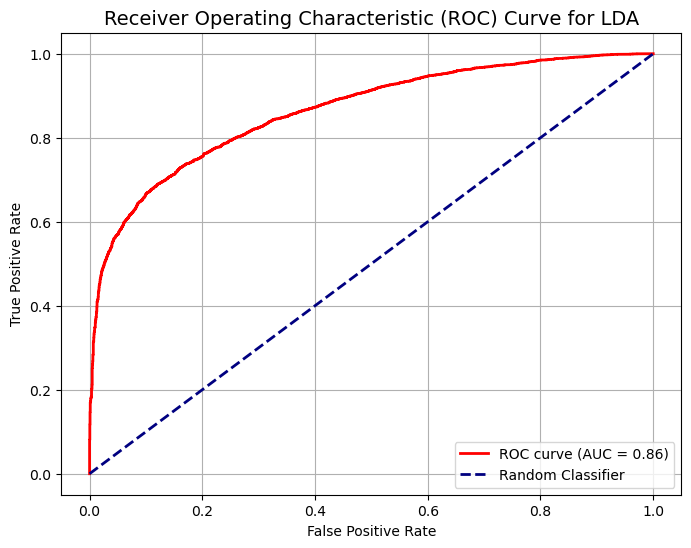

In [70]:
final_model_pipeline_lda = Pipeline([
    ('scaler', StandardScaler()),
    ('lda', LDA(solver="lsqr", shrinkage="auto"))
])

final_model_pipeline_lda.fit(X_imputed[best_features_lda], y)

y_prob_lda = final_model_pipeline_lda.predict_proba(X_imputed[best_features_lda])[:, 1]

# Compute ROC curve values: False Positive Rate (fpr), True Positive Rate (tpr), and thresholds
fpr_lda, tpr_lda, thresholds_lda = roc_curve(y, y_prob_lda)

# Compute Area Under the Curve (AUC)
roc_auc_lda = auc(fpr_lda, tpr_lda)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_lda, tpr_lda, color='red', lw=2,
         label='ROC curve (AUC = {:.2f})'.format(roc_auc_lda))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for LDA', fontsize=14)
plt.legend(loc="lower right")
plt.grid(True)
plt.show();

> QDA roc

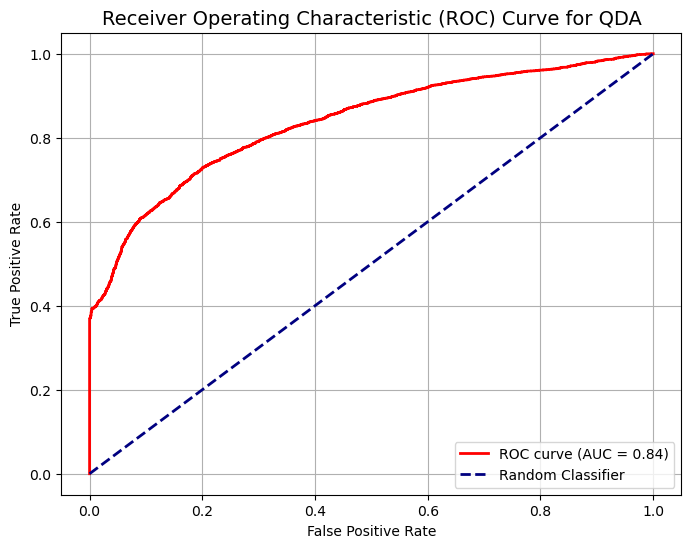

In [71]:
model_pipeline_qda = Pipeline([
        ('scaler', StandardScaler()),
        ('qda', QDA()) # Default QDA parameters
    ])
final_model_pipeline_qda.fit(X_imputed[best_features_qda], y)

y_prob_qda = final_model_pipeline_qda.predict_proba(X_imputed[best_features_qda])[:, 1]

# Compute ROC curve values: False Positive Rate (fpr), True Positive Rate (tpr), and thresholds
fpr_qda, tpr_qda, thresholds_qda = roc_curve(y, y_prob_qda)

# Compute Area Under the Curve (AUC)
roc_auc_qda = auc(fpr_qda, tpr_qda)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_qda, tpr_qda, color='red', lw=2,
         label='ROC curve (AUC = {:.2f})'.format(roc_auc_qda))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for QDA', fontsize=14)
plt.legend(loc="lower right")
plt.grid(True)
plt.show();

> knn roc


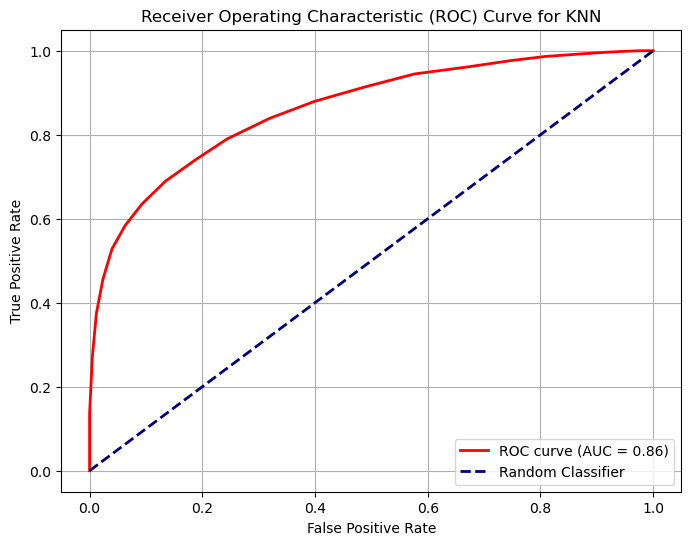

In [72]:
y_prob_knn = best_knn_model.predict_proba(X_imputed)[:, 1]

# Compute ROC curve values: False Positive Rate (fpr), True Positive Rate (tpr), and thresholds
fpr_knn, tpr_knn, thresholds_knn = roc_curve(y, y_prob_knn)

# Compute Area Under the Curve (AUC)
roc_auc_knn = auc(fpr_knn, tpr_knn)

# Plot the ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_knn, tpr_knn, color='red', lw=2,
         label='ROC curve (AUC = {:.2f})'.format(roc_auc_knn))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve for KNN')
plt.legend(loc="lower right")
plt.grid(True)
plt.show();

# CONCLUSION


All the curves besides the QDA are very similar with the same 0.86 score. In order to choose the optimal classifier we have to rely on the previous analysis on accuracy and sensitivity. Since Logistic Regression had the highest results in both of them, performed slightly better than LDA, leading it to be the best classifier overall.

<div style="border: 2px solid; padding: 10px; border-radius: 5px;">
<div align="center">

# CLUSTERING

</div>

> The goal is to cluster the data in order to explain the different classes of the sfdm2 variable on the income of patients. First of all, separate our target and check for null values, in order to scale and impute them before clustering. Then check if the data are linearly separable observing if with 2 Principal Components the classes are separated.

1275
8217


<Figure size 800x600 with 0 Axes>

Text(0.5, 1.0, 'PCA colored by sfdm2')

Text(0.5, 0, 'PC1')

Text(0, 0.5, 'PC2')

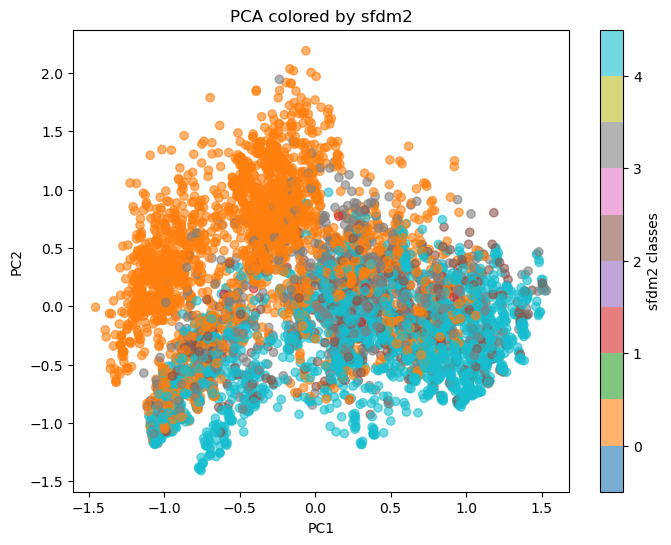

0: <2 mo. follow-up
1: Coma or Intub
2: SIP>=30
3: adl>=4 (>=5 if sur)
4: no(M2 and SIP pres)


In [73]:
# clustering
# separate sfdm2 before the clustering

print(dataset["sfdm2"].isnull().sum())
print(dataset["sfdm2"].size)

dataset.dropna(subset=["sfdm2"], inplace=True)


target = dataset["sfdm2"]
X = pd.get_dummies(dataset.drop(columns=["sfdm2"]), drop_first=True)

scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)

imputer = KNNImputer(n_neighbors=5)
X_imputed = imputer.fit_transform(X_scaled)

# replace missing values with imputed
X_imputed = pd.DataFrame(X_imputed, columns=X.columns)


# check if classes are separable before clustering
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Reduce to 2D for visualization
pca = PCA(n_components=2)
X_2d = pca.fit_transform(X_imputed)

# Convert target (sfdm2) to numeric labels for plotting
le = LabelEncoder()
labels_encoded = le.fit_transform(target)

# Plot
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_2d[:, 0], X_2d[:, 1], c=labels_encoded, cmap='tab10', alpha=0.6)
plt.title("PCA colored by sfdm2")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.colorbar(scatter, ticks=range(len(le.classes_)), label="sfdm2 classes")
plt.clim(-0.5, len(le.classes_)-0.5)
plt.show()

for i, class_name in enumerate(le.classes_):
    print(f"{i}: {class_name}")


The target classes (e.g., `sfdm2`) are not linearly separable in the current feature space, which limits the effectiveness of models that rely on distance-based separation. The available features do not provide a clear distinction between classes, resulting in overlapping distributions and poorly defined boundaries. Consequently, a low clustering score (e.g., silhouette score or adjusted Rand index) is expected when applying clustering methods directly on the high-dimensional raw data.

To address this, dimensionality reduction is applied using Principal Component Analysis (PCA), reducing the feature space to 40 principal components. This step helps to remove noise and retain the most informative patterns. With the transformed, lower-dimensional representation, Agglomerative Hierarchical Clustering can be performed, potentially yielding improved cluster structure and interpretability compared to clustering on the original feature set.


In [74]:
# agglomerative 
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score, silhouette_score
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import dendrogram, linkage

pca = PCA(n_components=40)
X_pca = pca.fit_transform(X_imputed)
print(f"Explained variance ratio: {pca.explained_variance_ratio_.sum():.2f}")

agg = AgglomerativeClustering(n_clusters=len(np.unique(target)), metric='euclidean', linkage='ward')
clusters = agg.fit_predict(X_pca)

# scores
ari = adjusted_rand_score(target, clusters)
sil = silhouette_score(X_pca, clusters)

print(f"Adjusted Rand Index Euclidean ward: {ari:.4f}")
print(f"Silhouette Score Euclidean ward: {sil:.4f}")

agg = AgglomerativeClustering(n_clusters=len(np.unique(target)), metric='euclidean', linkage='complete')
clusters = agg.fit_predict(X_pca)

# scores
ari = adjusted_rand_score(target, clusters)
sil = silhouette_score(X_pca, clusters)

print(f"Adjusted Rand Index Euclidean complete: {ari:.4f}")
print(f"Silhouette Score Euclidean complete: {sil:.4f}")

agg = AgglomerativeClustering(n_clusters=len(np.unique(target)), metric='euclidean', linkage='average')
clusters = agg.fit_predict(X_pca)

# scores
ari = adjusted_rand_score(target, clusters)
sil = silhouette_score(X_pca, clusters)

print(f"Adjusted Rand Index Euclidean average: {ari:.4f}")
print(f"Silhouette Score Euclidean average: {sil:.4f}")

agg = AgglomerativeClustering(n_clusters=len(np.unique(target)), metric='euclidean', linkage='single')
clusters = agg.fit_predict(X_pca)

# scores
ari = adjusted_rand_score(target, clusters)
sil = silhouette_score(X_pca, clusters)

print(f"Adjusted Rand Index Euclidean single: {ari:.4f}")
print(f"Silhouette Score Euclidean single: {sil:.4f}")

agg = AgglomerativeClustering(n_clusters=len(np.unique(target)), metric='manhattan', linkage="complete")

# scores
ari = adjusted_rand_score(target, clusters)
sil = silhouette_score(X_pca, clusters)

print(f"Adjusted Rand Index Manhattan complete: {ari:.4f}")
print(f"Silhouette Score Manhattan complete: {sil:.4f}")

agg = AgglomerativeClustering(n_clusters=len(np.unique(target)), metric='manhattan', linkage="average")

# scores
ari = adjusted_rand_score(target, clusters)
sil = silhouette_score(X_pca, clusters)

print(f"Adjusted Rand Index Manhattan average: {ari:.4f}")
print(f"Silhouette Score Manhattan average: {sil:.4f}")

agg = AgglomerativeClustering(n_clusters=len(np.unique(target)), metric='manhattan', linkage="single")

# scores
ari = adjusted_rand_score(target, clusters)
sil = silhouette_score(X_pca, clusters)

print(f"Adjusted Rand Index Manhattan single: {ari:.4f}")
print(f"Silhouette Score Manhattan single: {sil:.4f}")

Explained variance ratio: 1.00
Adjusted Rand Index Euclidean ward: 0.0243
Silhouette Score Euclidean ward: 0.1400
Adjusted Rand Index Euclidean complete: 0.0305
Silhouette Score Euclidean complete: 0.1438
Adjusted Rand Index Euclidean average: 0.0033
Silhouette Score Euclidean average: 0.0824
Adjusted Rand Index Euclidean single: 0.0003
Silhouette Score Euclidean single: 0.0766
Adjusted Rand Index Manhattan complete: 0.0003
Silhouette Score Manhattan complete: 0.0766
Adjusted Rand Index Manhattan average: 0.0003
Silhouette Score Manhattan average: 0.0766
Adjusted Rand Index Manhattan single: 0.0003
Silhouette Score Manhattan single: 0.0766


As expected the results are very low

## Now we will calculate some metrics:

- quantitative purity evaluation of clustering.

- An interactive 3D visualization using t-SNE.

- Ability to better understand how well predicted clusters align with actual class labels.

In [75]:
def get_Ncounts(y_predict, y_true, k, j=None):
    N = y_predict.shape[0]
    Nk_mask = y_predict==k
    Nk = Nk_mask.sum()
    Nj, Nkj = None, None
    if j is not None:
        Nj_mask = y_true==j
        Nj = Nj_mask.sum()
        Nkj = np.logical_and(Nk_mask, Nj_mask).sum()
    return N, Nk, Nj, Nkj

def precision(y_predict, y_true, k, j):
    N, Nk, Nj, Nkj = get_Ncounts(y_predict, y_true, k, j)
    return Nkj / (Nk + 1e-8)

def purity(y_predict, y_true, k):
    cls = np.unique(y_true)
    prec = [precision(y_predict, y_true, k, j) for j in cls]
    return max(prec)

def tot_purity(y_predict, y_true):
    N = y_true.shape[0]
    nc = len(np.unique(y_true))
    p = 0
    for k in range(nc):
        N, Nk, _, _ = get_Ncounts(y_predict, y_true, k)
        pk = purity(y_predict, y_true, k)
        p += (Nk / N) * pk
    return p

import plotly.express as px
from sklearn.manifold import TSNE

def plot3d_tsne(X, labels):
    # Prepare data
    tsne = TSNE(n_components=3)
    X = X.reshape(X.shape[0], -1)
    X_tsne = tsne.fit_transform(X)

    # Create DataFrame for Plotly
    import pandas as pd
    df = pd.DataFrame({
        'tSNE_1': X_tsne[:,0],
        'tSNE_2': X_tsne[:,1],
        'tSNE_3': X_tsne[:,2],
        'Label': labels.astype(str)
    })

    # Create 3D scatter plot
    fig = px.scatter_3d(
        df,
        x='tSNE_1', y='tSNE_2', z='tSNE_3',
        color='Label',
        title="3D tSNE of Digits Dataset"
    )

    # Increase marker size
    fig.update_traces(marker=dict(size=5))  # Try size=6 or 7 for even bigger

    # Increase overall figure size
    fig.update_layout(
        width=900,
        height=800,
        legend_title_text='Digit Class',
        margin=dict(l=0, r=0, b=0, t=40)
    )

    fig.show()

print(X_imputed.shape)

(6942, 50)


In [76]:
# DBSCAN tuning eps with k-distance
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import LabelEncoder

model = DBSCAN(eps=2, min_samples=5)
y_predict = model.fit_predict(X_imputed)

# since score 0.311 use PCA to improve removing noise and redundant info

model = DBSCAN(eps=2, min_samples=5)
y_predict = model.fit_predict(X_pca)

le = LabelEncoder()
labels_encoded = le.fit_transform(target)

plot3d_tsne(X_pca, labels_encoded)

> From the 3D plot is clearly visible that there is a sort of pattern in the division between clusters, but it is also notable that data are quiet mixed.

<Figure size 1000x600 with 0 Axes>

Text(0.5, 0, 'Points sorted by distance')

Text(0, 0.5, 'Distance to 5-th nearest neighbor')

Text(0.5, 1.0, 'K-distance Graph for DBSCAN (min_samples=5)')

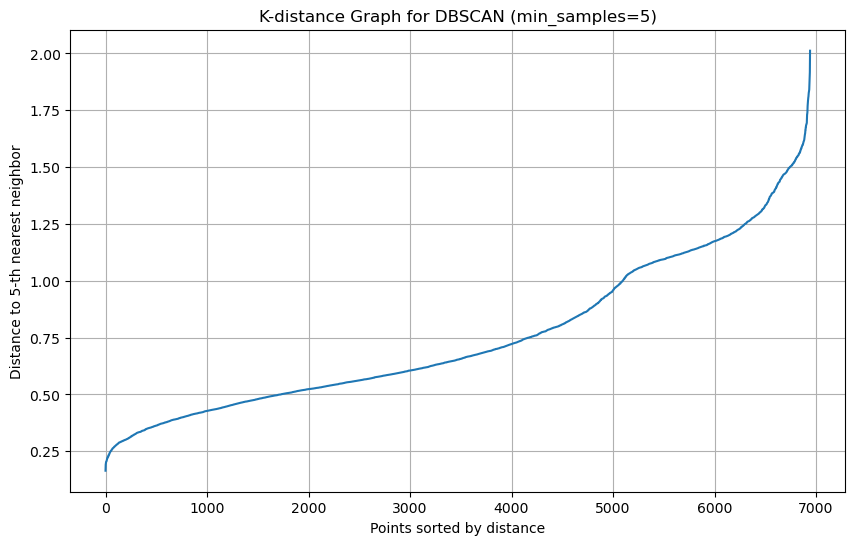

ari = 0.014749874697995694
Silhouette = 0.43976953674043795
  Number of clusters (excluding noise): 196
  Number of noise points: 3253


In [77]:
# DBSCAN tuning eps with k-distance
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import LabelEncoder

model = DBSCAN(eps=2, min_samples=5)
y_predict = model.fit_predict(X_imputed)

# since score 0.311 use PCA to improve removing noise and redundant info

from sklearn.neighbors import NearestNeighbors

min_samples = 5 # Or choose another value

# Calculate distances to the (min_samples)-th nearest neighbor
neighbors = NearestNeighbors(n_neighbors=min_samples)
neighbors_fit = neighbors.fit(X_pca)
distances, indices = neighbors_fit.kneighbors(X_pca)

# Sort distances to the (min_samples-1)-th neighbor (since kneighbors includes the point itself)
distances = np.sort(distances[:, min_samples-1], axis=0)

plt.figure(figsize=(10, 6))
plt.plot(distances)
plt.xlabel("Points sorted by distance")
plt.ylabel(f"Distance to {min_samples}-th nearest neighbor")
plt.title(f"K-distance Graph for DBSCAN (min_samples={min_samples})")
plt.grid(True)
plt.show();

# Look for the change in shape in the plot to determine the optimal eps                                                  
# eps = 0.6
model = DBSCAN(eps=0.6, min_samples=5)
y_predict = model.fit_predict(X_pca)

le = LabelEncoder()
labels_encoded = le.fit_transform(target)

ari = adjusted_rand_score(labels_encoded, y_predict)
mask = y_predict != -1
silhouette = None
if len(set(y_predict[mask])) > 1:
    silhouette = silhouette_score(X_pca[mask], y_predict[mask])

print(f"ari = {ari}")
print(f"Silhouette = {silhouette}")
print(f"  Number of clusters (excluding noise): {len(set(y_predict[mask]))}")
print(f"  Number of noise points: {np.sum(y_predict==-1)}")

The clustering result shows a very low Adjusted Rand Index (ARI = 0.0147), indicating that the clusters found do not correspond well to the true class labels. The silhouette score is moderately high (0.4398), suggesting that the clusters are relatively well separated in the feature space, despite not matching the ground truth. The model identified 196 clusters, excluding 3253 noise points, which points to an over-fragmented clustering structure likely caused by high dimensionality or inappropriate parameter settings.

Implement a function to compute a cluster evaluation, quantifying how well the clusters align with the structure of the data. 
Then compare it to random clustering of the data.

In [78]:
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import normalize

def incidence_mat(y_pred):
    npoints = y_pred.shape[0]
    mat = np.zeros([npoints, npoints])
    # Retrieve how many different cluster ids there are
    clusters = np.unique(y_pred)
    nclusters = clusters.shape[0]
    
    for i in range(nclusters):
        sample_idx = np.where(y_pred==i)#... indices of the samples in this cluster
        # Compute combinations of these indices
        idx = np.meshgrid(sample_idx, sample_idx)
        mat[idx[0], idx[1]] = 1
        
    return mat

def similarity_mat(X, metric):
    dist_mat = pairwise_distances(X, metric=metric)
    min_dist, max_dist = dist_mat.min(), dist_mat.max()
    
    # Normalize distances in [0, 1] and compute the similarity
    sim_mat = 1 - (dist_mat-min_dist)/(max_dist-min_dist)
    return sim_mat

def correlation(X, y_pred, metric):
    inc = incidence_mat(y_pred)
    sim = similarity_mat(X, metric)
    
    # Note: we can eventually remove duplicate values
    # only the upper/lower triangular matrix
    # triuidx = np.triu_indices(y_pred.shape[0], k=1)
    # inc = inc[triuidx]
    # sim = sim[triuidx]
    
    inc = normalize(inc.reshape(1,-1))
    sim = normalize(sim.reshape(1,-1))
    corr = inc@sim.T # [1,NF] [NF,1] = [1,1]
    return corr[0,0]   

print("Correlation Score: ", correlation(X_pca, y_predict, 'euclidean'))

# random clustering
n_clusters=10
y_rand = np.random.randint(0, n_clusters, y_predict.shape[0]) #randomly assign integers to y.shape[0] samples, in range [0, n_clusters-1]

print("Random Correlation Score: ", correlation(X_pca, y_rand, 'euclidean'))

Correlation Score:  0.1144650855541352
Random Correlation Score:  0.30519062970869326


> The results show a poor correlation score with respect to random assigned clustering, so meaningful clusters were not found in the data.

Produce a Heatmap to observe if some of the variables cluster together, in order to have an insight about some correlations.

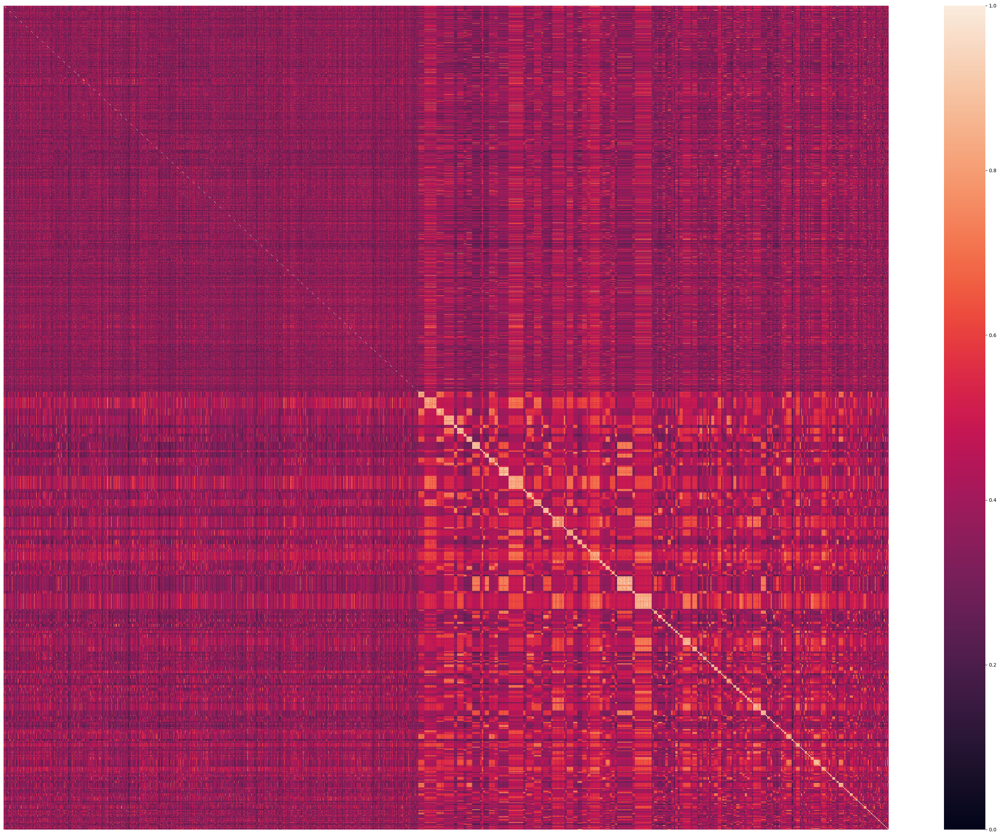

In [79]:
# Plot an exploration heatmap
def sorted_mat(sim, y_pred):
    idx_sorted = np.argsort(y_pred) #idx of sorted values
    # Sort the rows
    sim = sim[idx_sorted,:]
    # Sort the columns
    sim = sim[:,idx_sorted]
    
    return sim

def plot_sorted_mat(sim, y_pred):
    sim = sorted_mat(sim, y_pred)
    
    fig, ax = plt.subplots(figsize=(40,30))  
    ax = sns.heatmap(sim, ax=ax)
    # Remove ruler (ticks)
    ax.set_yticks([]) 
    ax.set_xticks([])

# Try to select different distances!
sim = similarity_mat(X_pca, metric='euclidean')
# plot sorted 
plot_sorted_mat(sim, y_predict)

Even if we observe some squares in the bottom right part of the heatmap, in general we do not observe any precise cluster through the data.

In [80]:
def wss(X, y_pred, metric):
    # Compute the incidence matrix
    inc = incidence_mat(y_pred)
    # Compute the distances between each pair of nodes
    dist_mat = pairwise_distances(X, metric=metric)
    # Use the incidence matrix to select only the 
    # distances between pair of nodes in the same cluster
    dist_mat = dist_mat*inc
    # Select the lower/upper triangular part of the matrix
    # excluding the diagonal
    triu_idx = np.triu_indices(X.shape[0], k=1)
    
    wss = (dist_mat[triu_idx]**2).sum()
    
    return wss

def bss(X, y_pred, metric):
    # Compute the incidence matrix
    inc = incidence_mat(y_pred)
    # Compute the distances between each pair of nodes
    dist_mat = pairwise_distances(X, metric=metric)
    # Use the incidence matrix to select only the 
    # distances between pair of nodes in different clusters
    dist_mat = dist_mat*(1-inc)
    # Select the lower/upper triangular part of the matrix
    # excluding the diagonal
    triu_idx = np.triu_indices(X.shape[0], k=1)
    
    bss = (dist_mat[triu_idx]**2).sum()
    
    return bss

print("WSS pca", wss(X_pca, y_predict, 'euclidean'))
print("BSS pca", bss(X_pca, y_predict, 'euclidean'))

WSS pca 43351.09540170779
BSS pca 163563301.7184935


From the WSS and BSS we can see that the clusters are indeed separated since the BSS is orders of magnitude larger than WSS, even if it is quite large.

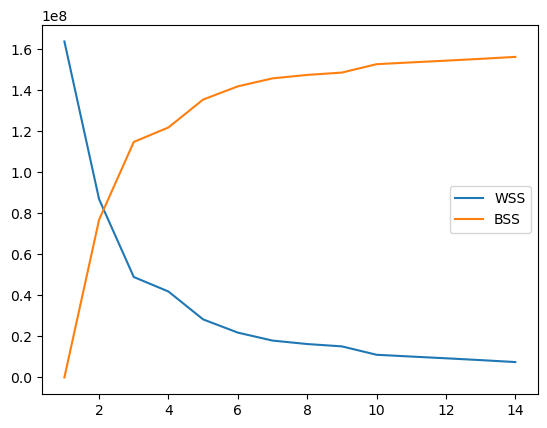

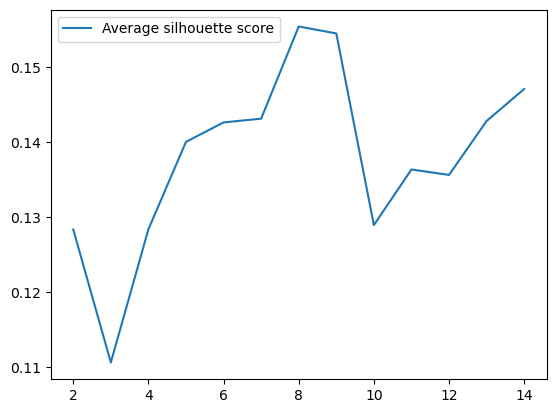

In [81]:
from sklearn.metrics import silhouette_score

wss_list, bss_list, sil_list = [], [], []
clus_list = list(range(1, 15))

for nc in clus_list:
    model = AgglomerativeClustering(n_clusters=nc,
                                    metric='euclidean', 
                                    linkage='ward')

    y_predict = model.fit_predict(X_pca)
    
    wss_list.append(wss(X_pca, y_predict, 'euclidean'))
    bss_list.append(bss(X_pca, y_predict, 'euclidean'))
    if nc > 1:
        sil_list.append(silhouette_score(X_pca, y_predict, metric='euclidean'))
    
plt.plot(clus_list, wss_list, label='WSS')
plt.plot(clus_list, bss_list, label='BSS')
plt.legend()
plt.show();

plt.plot(clus_list[1:], sil_list, label='Average silhouette score')
plt.legend()

From the first graph the relationship between WSS and BSS can be observed, after few units they begin to diverge. 
Then in the average silhouette how the score changes with the clusters number, leading to have more clusters than the 5 of our target variable as optimal number. 
This underline how our data are not able to separate according to the sfdm2 feature.

> Since the methods reached very low score, we tried k-means, using both random initialization and a second one performing 100 iterations and retaining the best.

In [82]:
# k-means
import os
os.environ["OMP_NUM_THREADS"] = "1"

from sklearn.cluster import KMeans
model = KMeans(n_clusters=5, init='k-means++', random_state=0, n_init=10, max_iter=100)
y_predict = model.fit_predict(X_pca)

print("Kmeans++ purity", tot_purity(y_predict, target))

for i, class_name in enumerate(le.classes_):
    print(f"{i}: {class_name}")

plot3d_tsne(X_imputed.to_numpy(), labels=y_predict)

model = KMeans(n_clusters=5, init='random', random_state=0, n_init=10, max_iter=100)
y_predict = model.fit_predict(X_pca)

print("Kmeans random purity", tot_purity(y_predict, target))

Kmeans++ purity 0.6374243733748485
0: <2 mo. follow-up
1: Coma or Intub
2: SIP>=30
3: adl>=4 (>=5 if sur)
4: no(M2 and SIP pres)


Kmeans random purity 0.6372803226690008


k-means achieved the best result with a purity larger than 0.6. Now compare all the methods to see how they separate the data.

KMeans:
    Time: 1.55 sec
    Purity: 0.6371
Hierarchical (avg):
    Time: 1.81 sec
    Purity: 0.4479
Hierarchical (single):
    Time: 1.55 sec
    Purity: 0.4032
Hierarchical (complete):
    Time: 2.45 sec
    Purity: 0.5203
Hierarchical (ward):
    Time: 2.34 sec
    Purity: 0.5065
DBSCAN:
    Time: 3.93 sec
    Purity: 0.4029


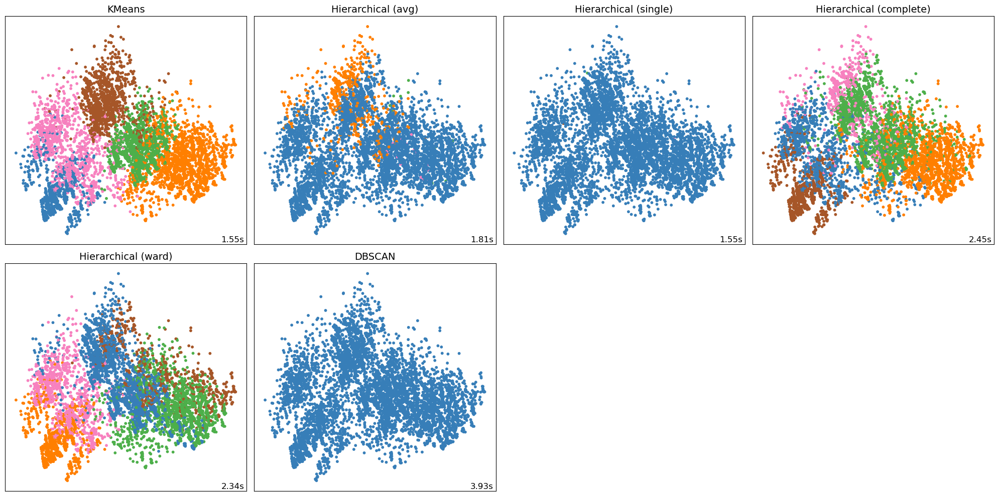

In [83]:
# algorithm comparison
import time
from sklearn import cluster
from itertools import cycle, islice

n_clusters = len(np.unique(target))  # Check this isn't too large

# Clustering algorithms to test
clustering_algorithms = [
    ('KMeans', cluster.KMeans(n_clusters=n_clusters, init="random", n_init=10)),
    ('Hierarchical (avg)', cluster.AgglomerativeClustering(n_clusters=n_clusters, linkage='average')),
    ('Hierarchical (single)', cluster.AgglomerativeClustering(n_clusters=n_clusters, linkage='single')),
    ('Hierarchical (complete)', cluster.AgglomerativeClustering(n_clusters=n_clusters, linkage='complete')),
    ('Hierarchical (ward)', cluster.AgglomerativeClustering(n_clusters=n_clusters, linkage='ward')),
    ('DBSCAN', DBSCAN(eps=10, min_samples=30)),
]

# Plot setup
plt.figure(figsize=(20, 10))
plot_num = 1

for name, algorithm in clustering_algorithms:
    t0 = time.time()
    algorithm.fit(X_pca)
    t1 = time.time()

    # Get cluster labels
    y_pred = algorithm.labels_ if hasattr(algorithm, 'labels_') else algorithm.predict(X_pca)

    # purity
    purity_score = tot_purity(y_pred, target)

    print(f"{name}:")
    print(f"    Time: {t1 - t0:.2f} sec")
    print(f"    Purity: {purity_score:.4f}")

    # Plotting
    plt.subplot(2, len(clustering_algorithms) // 2 + 1, plot_num)
    plt.title(name, size=14)

    colors = np.array(list(islice(cycle(['#377eb8', '#ff7f00', '#4daf4a',
                                         '#f781bf', '#a65628', '#984ea3',
                                         '#999999', "#db1a1d", '#dede00']),
                                  int(max(y_pred) + 1))))
    colors = np.append(colors, ["#000000"])  # for noise/outliers

    plt.scatter(X_pca[:, 0], X_pca[:, 1], s=10, color=colors[y_pred])
    plt.xticks(())
    plt.yticks(())
    plt.text(.99, .01, ('%.2fs' % (t1 - t0)).lstrip('0'),
             transform=plt.gca().transAxes, size=12,
             horizontalalignment='right')
    plot_num += 1

plt.tight_layout()
plt.show();

# CONCLUSION

 The best methods were the k-means and hierarchical with average distance having cluster purity of about 0.6. However, the conclusion is that the methods employed suffer too much the high dimensionlity of the data and so they were not able to separate the data based on the classes with an acceptable score.